# Setup

Constructing scheme
Setting up grid
Reading in initial conditions
Setting up fourier grid
Constructing scheme
Setting up grid
Reading in initial conditions
Setting up fourier grid
Advection:  2343750.0  Diffusion:  0.002197265625  Acceleration:  1224.744871391589
t = 0 dt = 0.0010986328125 
min density = 0.8796735051726424 max density = 1.108890866769744
min density = 0.8796735051726424 max density = 1.108890866769744
min density = 0.8796735051726424 max density = 1.108890866769744
Advection:  31.289778973975782  Diffusion:  0.002197265625  Acceleration:  2.0527849218290712
t = 0.0010986328125 dt = 0.0010986328125 
min density = 0.879677557644377 max density = 1.108887607243754
min density = 0.879677557644377 max density = 1.108887607243754
min density = 0.879677557644377 max density = 1.108887607243754
Advection:  7.225792833767745  Diffusion:  0.002197265625  Acceleration:  0.9864621771690925
t = 0.002197265625 dt = 0.0010986328125 
min density = 0.8796984658571165 max density = 1.10

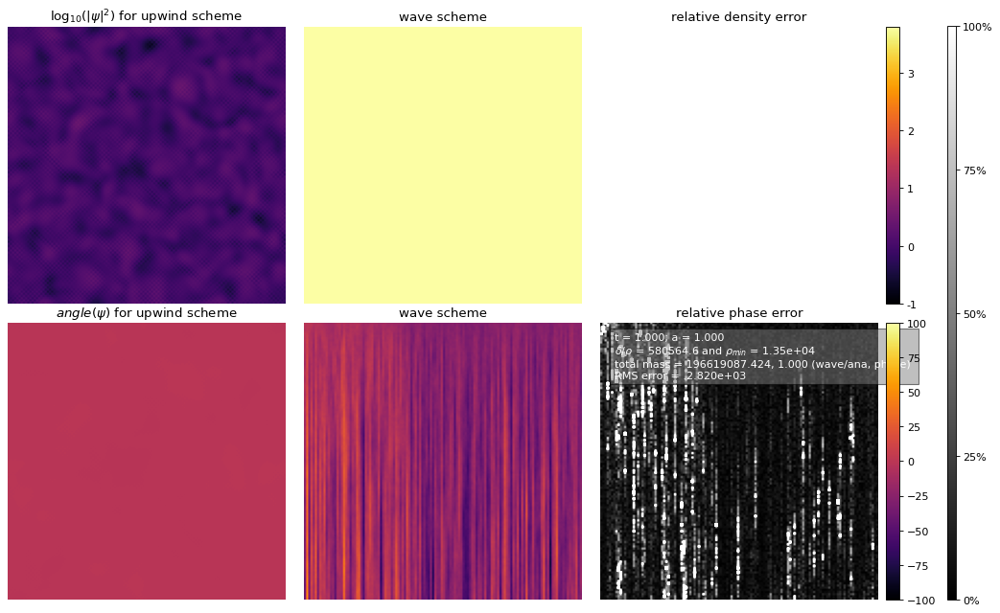

In [3]:
import schemes
import wave_schemes
import phase_schemes
import tests
import config
import analysis
import animation
import matplotlib.pyplot as plt
import numpy as np

c = config.generateConfig(dt=1e-4, t0=0)

def resetConfig(c):
    c["dt"] = 1e-3
    c["domainSize"] = 12
    c["resolution"] = 128
    c["timeOrder"] = 3
    c["stencilOrder"] = 4
    c["dimension"] = 2
    c["plotPhaseMod2"] = True
    #c["phaseYlim"] = [-3.14, 3.14]
    c["densityYlim"] = [0., 1.2]
    c["subregions"] = [[0.3, 0.3, 0.1, 0.1], [0.3, 0.3, 0.4, 0.4]]
    c["debug"] = False
    c["slowDown"] = 1
    c["tEnd"] = 1
    c["gravity"] = 1
    c["useAdaptiveSubregions"] = True
    c["maxSpeedC"] = 64/10
    c["useSlopeLimiting"] = True 
    c["fps"] = 1
    c["outputTimestep"] = True
    c["useAdaptiveTimestep"] = True 
    c["plotPhaseMod2"] = False
    c["phaseYlim"] = [-100, 100]
    

def test(xx, yy, dx, t):
    return tests.cosmological2D(xx, yy, dx, t, Lx=12, Ly=12, N=10, eps=5e-3)

#hsolver = sqchemes.HybridScheme(schemes.ConvectiveScheme, schemes.SubregionScheme, c, tests.cosmological2D)
resetConfig(c)
fsolver = wave_schemes.FTCSScheme(c, test)
hosolver  = phase_schemes.UpwindScheme(c, test)
#hosolver = phase_schemes.HOUpwindScheme(c, tests.cosmological2D)
fsolver.run()
#solver.run()
hosolver.run()
animation.drawFrame(hosolver, waveSolver=fsolver)
#animation.createAnimation(solver, "upwind scheme", c, tests.cosmological2D,    "upwind", fsolver)
#animation.createAnimation(solver, "ho upwind scheme", c, tests.cosmological2D, "ho_upwind", fsolver)

In [2]:
fsolver.t

1.0

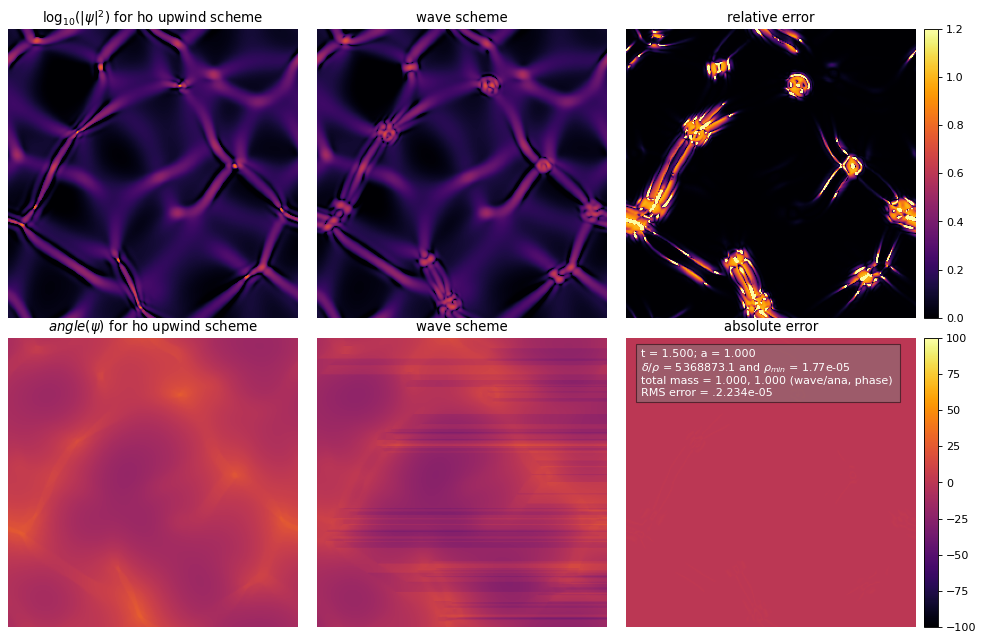

In [2]:
animation.drawFrame(hosolver, "ho upwind scheme", c, tests.cosmological2D, "lwu", fsolver)

In [21]:
import schemes
import wave_schemes
import phase_schemes
import tests
import config
import analysis
import animation
import matplotlib.pyplot as plt
import numpy as np

c, psi, density, phase = animation.loadRun("2d_runs/ho_upwind_4.npz")
c["tEnd"] = 1.5
c["stencilOrder"] = 4
hosolver = phase_schemes.HOUpwindScheme(c, tests.cosmological2D)
solver = phase_schemes.UpwindScheme(c, tests.cosmological2D)
fsolver = wave_schemes.SpectralScheme(c, tests.cosmological2D)
solver.cfl   = .1
hosolver.cfl = .1
solver.setDensity(density)
solver.setPhase(phase) 
hosolver.setDensity(density)
hosolver.setPhase(phase) 
fsolver.setPsi(psi)

In [7]:

fsolver = wave_schemes.SpectralScheme(c, tests.cosmological2D)
c["tEnd"] = 1.404
fsolver.setPsi(psi)

In [19]:
a = 0.75
hosolver.limiter = lambda r: np.maximum(0, np.minimum(2*r, np.minimum(a*r+1-a, 2)))

In [ ]:
a = 0.75
hosolver.limiter = lambda r: np.maximum(0, np.minimum(2*r, np.minimum(a*r+1-a, 2)))

In [9]:
solver.c1_coeff, solver.c1_stencil, solver.c2_coeff, solver.c2_stencil

(array([-0.5,  0. ,  0.5]),
 array([-1,  0,  1]),
 array([ 1., -2.,  1.]),
 array([-1,  0,  1]))

In [5]:
fsolver.run()
solver.run()

In [3]:
fsolver.run()

In [22]:
hosolver.run()

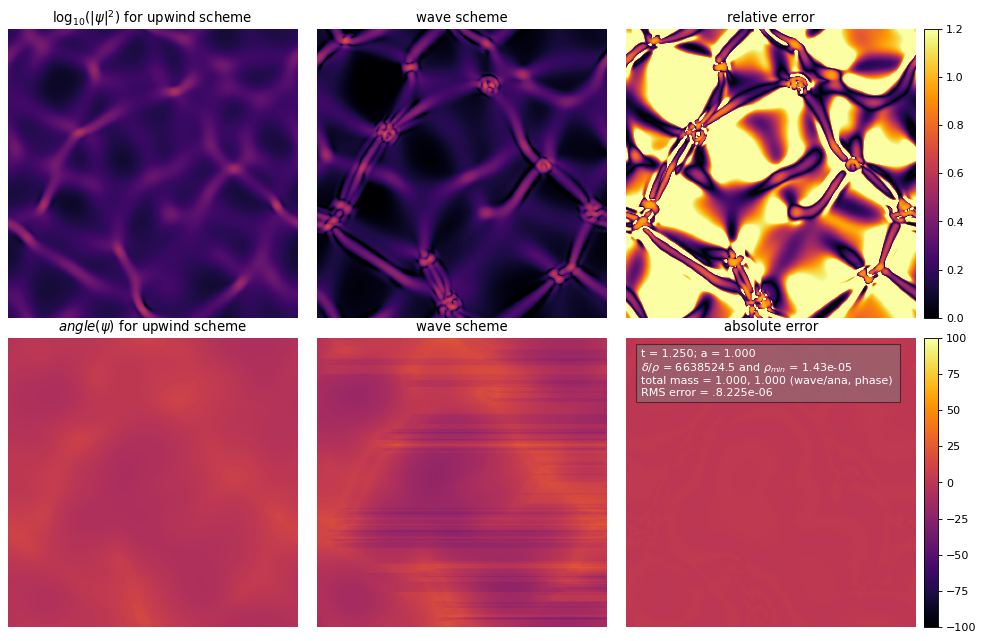

In [9]:
animation.drawFrame(solver, "upwind scheme", c, tests.cosmological2D, "lwu", fsolver)

In [6]:

hosolver = phase_schemes.HOUpwindScheme(c, tests.cosmological2D)
hosolver.run()

In [18]:
fsolver.run()

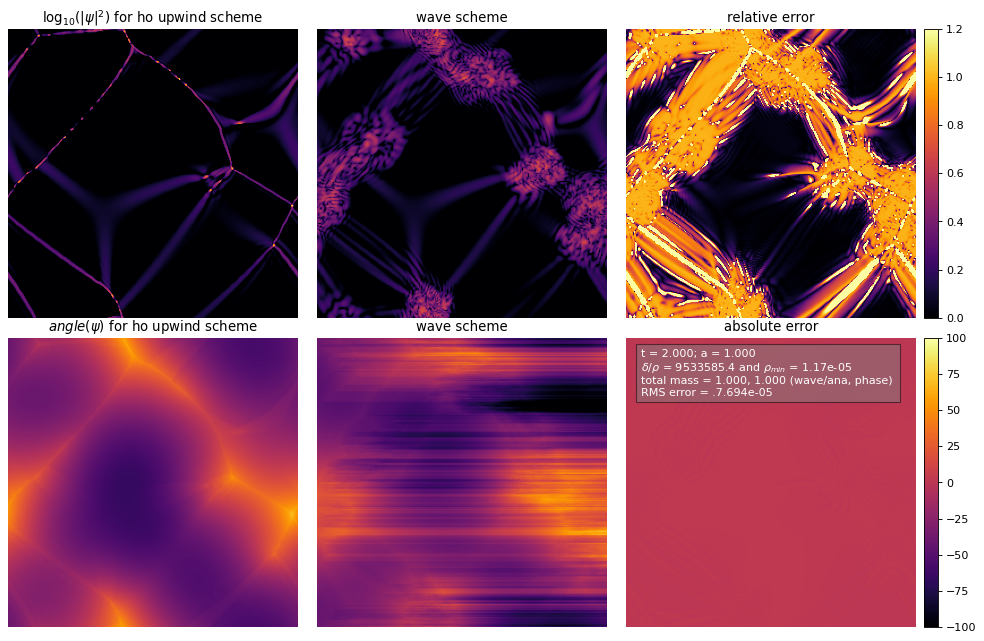

In [20]:
animation.drawFrame(hosolver, "ho upwind scheme", c, tests.cosmological2D, "lwu", fsolver)

In addition, when r < 0, that is when an extremum is encountered in the variation of
the solution u, it seems logical to set  = 0 corresponding to a zero slope in the interval
considered. This avoids non-monotone behaviors with changes of slope directions, at
the expense of a certain loss of accuracy

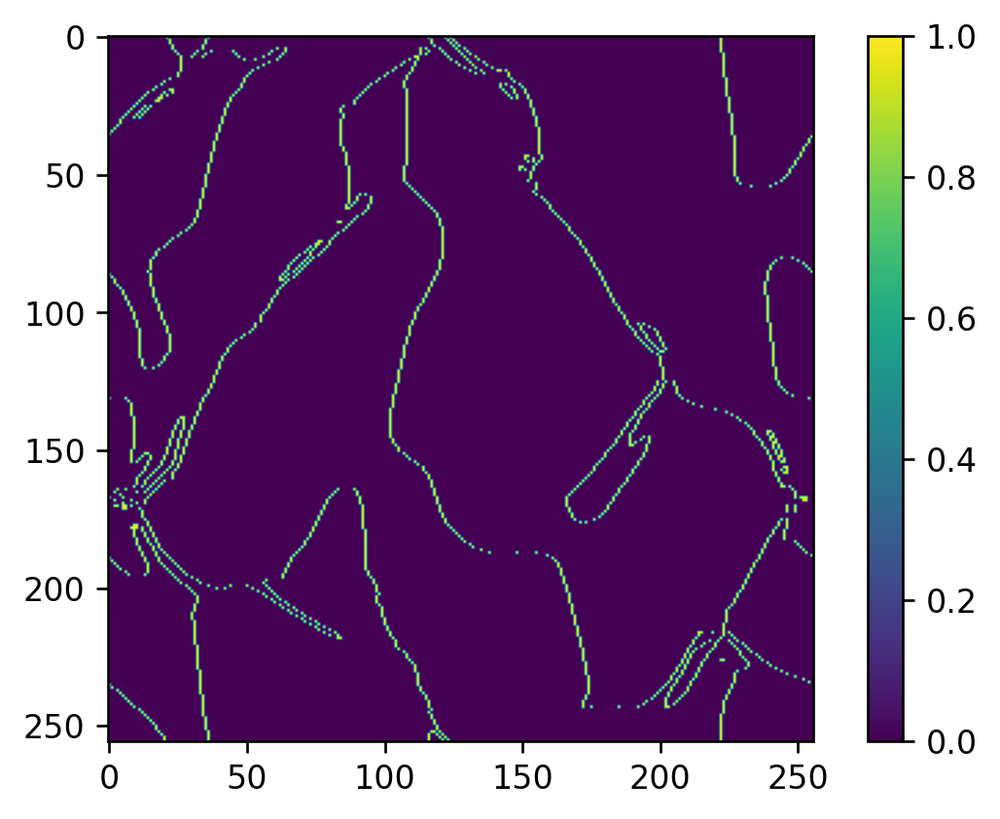

In [10]:
plt.figure(dpi = 240)
plt.imshow(hosolver.ql < 0)
plt.colorbar()

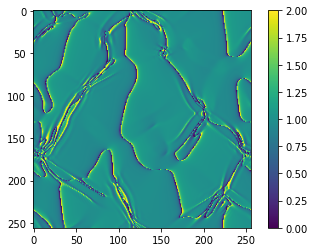

In [13]:
plt.imshow(hosolver.limiter(hosolver.ql, 0.75))
plt.colorbar()

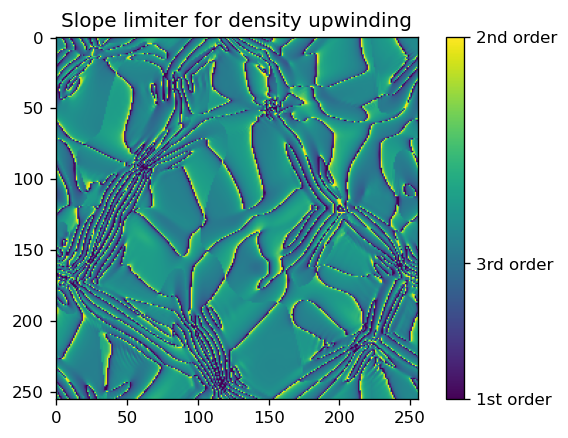

In [32]:
plt.figure(dpi = 120)
plt.title("Slope limiter for density upwinding")
plt.imshow(hosolver.limiterqm, cmap="viridis")
cbar = plt.colorbar()


cbar.set_ticks([0, 0.75, 2])
cbar.set_ticklabels(["1st order", "3rd order", "2nd order"])

plt.show()

## Test hybrid scheme

In [1]:
import schemes
import wave_schemes
import phase_schemes
import tests
import config
import analysis
import animation
import matplotlib.pyplot as plt
import numpy as np

c = config.generateConfig(dt=1e-4, t0=0)

def resetConfig(c):
    c["dt"] = 1e-3
    c["domainSize"] = 25
    c["resolution"] = 128
    c["timeOrder"] = 2
    c["stencilOrder"] = 4
    c["dimension"] = 2
    c["plotPhaseMod2"] = True
    #c["phaseYlim"] = [-3.14, 3.14]
    c["densityYlim"] = [0., 1.2]
    c["subregions"] = [[0.3, 0.3, 0.1, 0.1], [0.3, 0.3, 0.4, 0.4]]
    c["debug"] = False
    c["slowDown"] = 1
    c["tEnd"] = .8
    c["gravity"] = 1
    c["useAdaptiveSubregions"] = True
    c["maxSpeedC"] = 64/10
    c["useSlopeLimiting"] = True 
    c["fps"] = 4
    c["outputTimestep"] = False
    c["useAdaptiveTimestep"] = True 
    c["plotPhaseMod2"] = False
    c["phaseYlim"] = [-100, 100]
    c["cfl"] = 0.1
    
resetConfig(c)

def test(xx, yy, dx, t):
    return tests.cosmological2D(xx, yy, dx, t, eps=5e-2)
hsolver = schemes.HybridScheme(phase_schemes.HOUpwindScheme, schemes.SubregionScheme, c, test)
hosolver = phase_schemes.HOUpwindScheme(c, test)
fsolver = wave_schemes.SpectralScheme(c, test)

Set up nD binary tree with N = 128


In [2]:
hsolver.run()

/media/xerox/INTENSO/hybrid_scheme/fd.py:175: RuntimeWarning: invalid value encountered in log
  logrho = np.log(rho)


KeyboardInterrupt: 

In [48]:
fsolver.run()

/media/xerox/INTENSO/hybrid_scheme/animation.py:350: RuntimeWarning: invalid value encountered in log10
  im1.set_array((np.log10(density_mod) + 1) / 4)


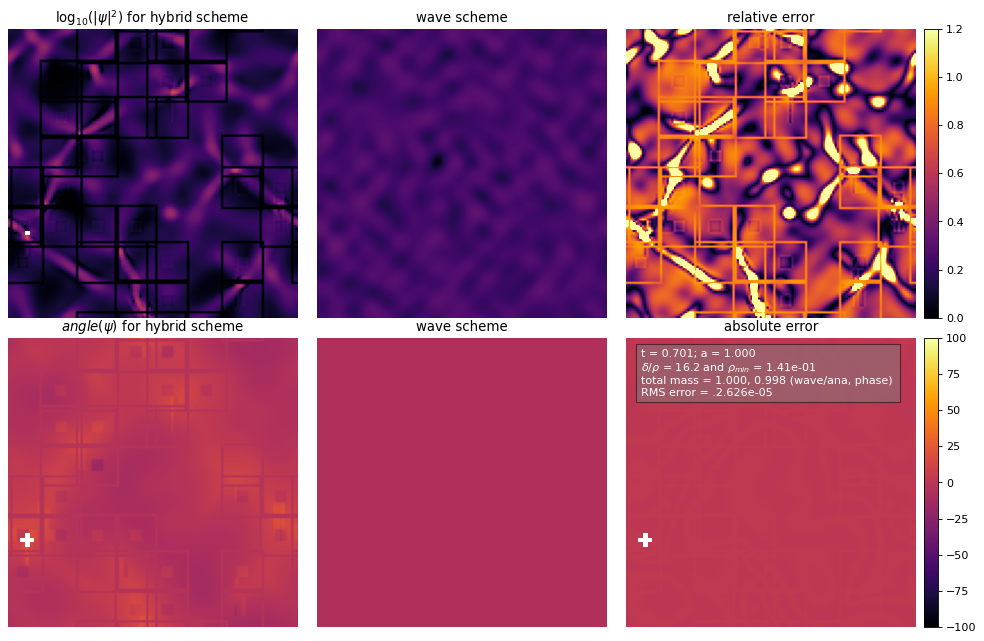

In [3]:
animation.drawFrame(hsolver, "hybrid scheme", c, tests.cosmological2D, "cosmo_hybrid_after_breakdown", fsolver)

In [28]:
while (not hsolver.subregions):
    hsolver.step(hsolver.getTimeStep())

Second order CN
Second order CN
Second order CN
Second order CN


/media/xerox/INTENSO/hybrid_scheme/fd.py:175: RuntimeWarning: invalid value encountered in log
  logrho = np.log(rho)


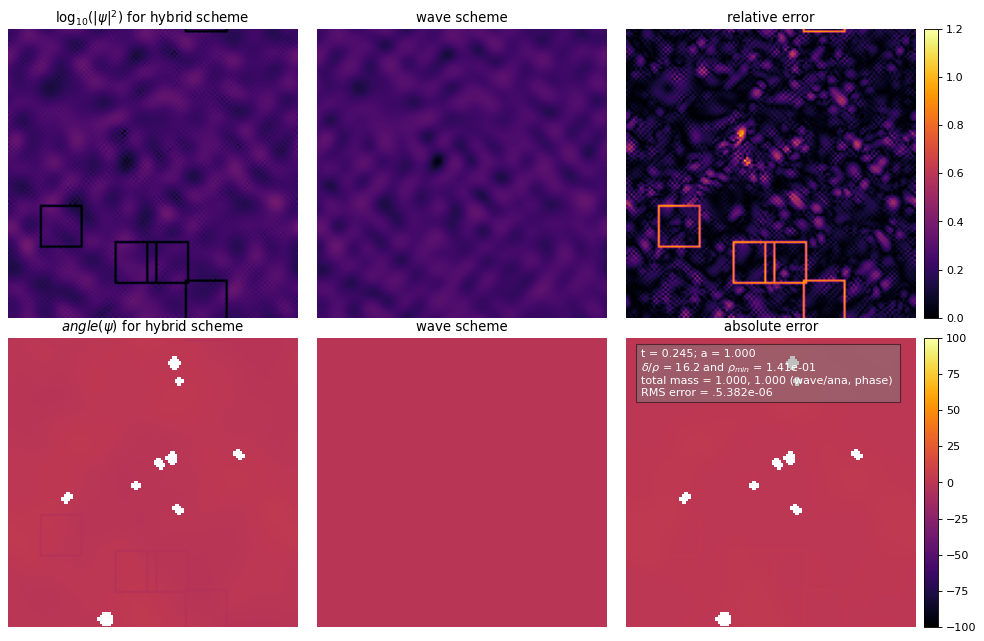

In [29]:
animation.drawFrame(hsolver, "hybrid scheme", c, tests.cosmological2D, "cosmo_hybrid_after_breakdown", fsolver)

#animation.drawFrame(hsolver, "hybrid scheme", c, tests.cosmological2D, "cosmo_hybrid_after_breakdown", fsolver)


In [1]:
import schemes
import phase_schemes 
import wave_schemes 

import tests
import config
import analysis
import animation

import numpy as np


c, psi, density, phase = animation.loadRun("2d_runs/ho_upwind_4.npz")
c["tEnd"] = 1.5
c["stencilOrder"] = 4
#hosolver = phase_schemes.HOUpwindScheme(c, tests.cosmological2D)
#solver = phase_schemes.UpwindScheme(c, tests.cosmological2D)
#fsolver = wave_schemes.SpectralScheme(c, tests.cosmological2D)
#solver.cfl   = .1
#hosolver.cfl = .1
#solver.setDensity(density)
#solver.setPhase(phase) 
#hosolver.setDensity(density)
#hosolver.setPhase(phase) 
#

hsolver = schemes.HybridScheme(phase_schemes.HOUpwindScheme, schemes.SubregionScheme, c, tests.cosmological2D)
#solver = schemes.ConvectiveScheme(config, tests.cosmological2D)
fsolver = wave_schemes.SpectralScheme(c, tests.cosmological2D)
hsolver.setDensity(density)
hsolver.setPhase(phase) 
fsolver.setPsi(psi)
#animation.createAnimation(hsolver, "hybrid scheme", config, tests.cosmological2D, "cosmo_hybrid_after_breakdown", fsolver)

Set up nD binary tree with N = 256


In [9]:
c["tEnd"] = 1.279
fsolver = wave_schemes.SpectralScheme(c, tests.cosmological2D)
fsolver.run()

In [5]:
hsolver.debug = False
for i in range(100):
    t  = hsolver.getTime()
    dt = hsolver.getTimeStep()
    print(f"Time t = {t} timestep dt = {dt}")
    hsolver.step(dt)


Time t = 1.2792002907648454 timestep dt = 0.003931104827397499


ValueError: Density array in compute potential contained nan

/media/xerox/INTENSO/hybrid_scheme/animation.py:350: RuntimeWarning: invalid value encountered in log10
  im1.set_array((np.log10(density_mod) + 1) / 4)


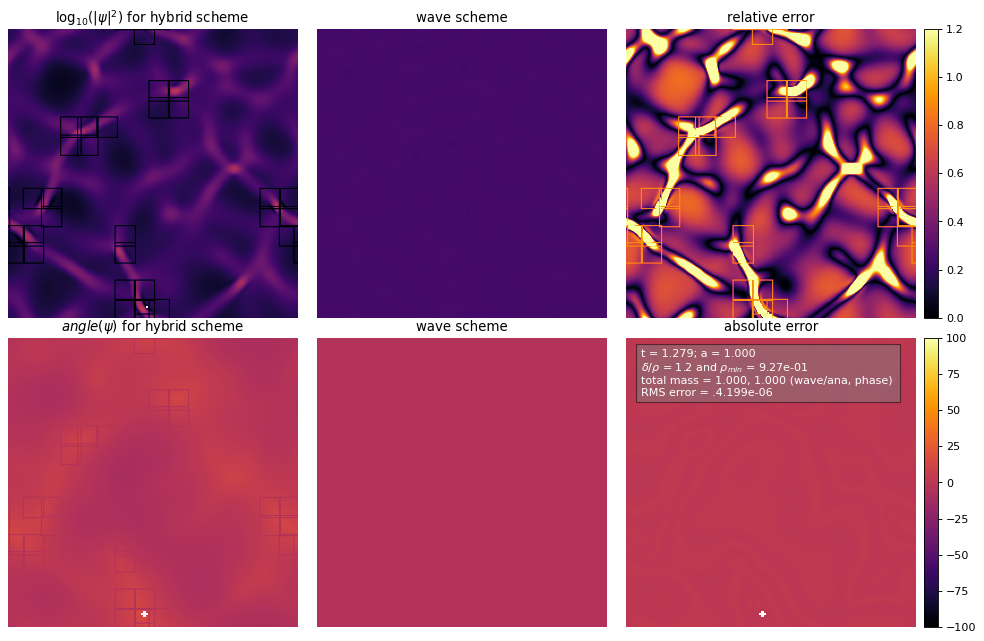

In [10]:
animation.drawFrame(hsolver, "hybrid scheme", c, tests.cosmological2D, "cosmo_hybrid_after_breakdown", fsolver)

In [2]:
hsolver.run()

KeyboardInterrupt: 

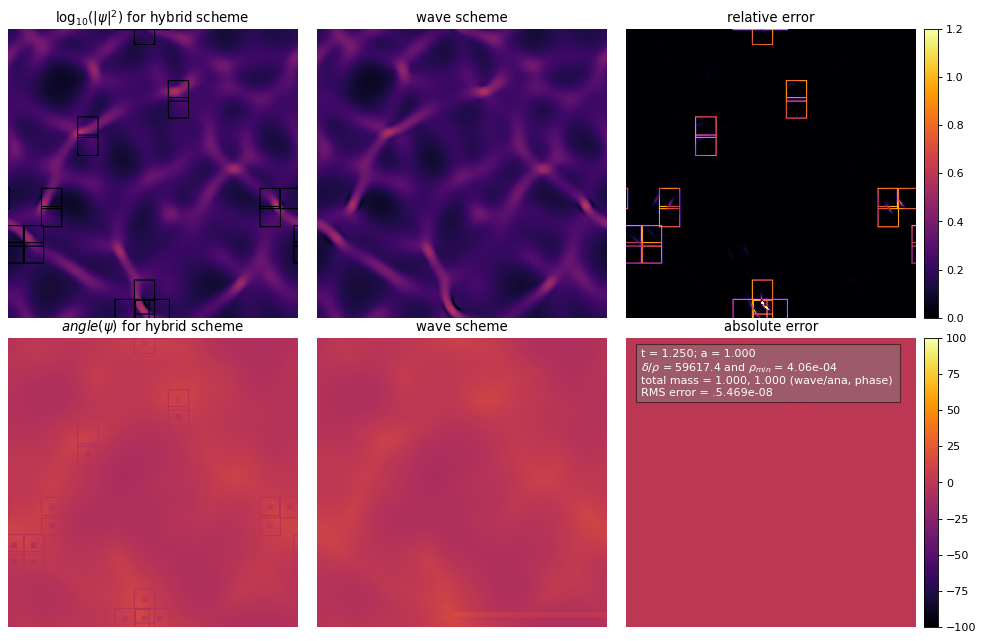

In [5]:
animation.drawFrame(hsolver, "hybrid scheme", c, tests.cosmological2D, "cosmo_hybrid_after_breakdown", fsolver)

In [6]:
import numpy as np 
r, rho, real, imag, rho_ana, real_ana, imag_ana = np.loadtxt("test.txt", skiprows=1, unpack=True)

In [9]:
np.arctan(imag_ana/real_ana)

array([ 0.58904862, -1.37444679, -0.19634954,  0.9817477 , -0.9817477 ,
        0.19634954,  1.37444679, -0.58904862,  0.58904862, -1.37444679,
       -0.19634954,  0.9817477 , -0.9817477 ,  0.19634954,  1.37444679,
       -0.58904862])

In [53]:
config["dpi"] = 80
import matplotlib.pyplot as plt 


/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)
/media/xerox/INTENSO/hybrid_scheme/schemes.py:583: RuntimeWarning: overflow encountered in exp
  density = np.exp(2 * sr)
/media/xerox/INTENSO/hybrid_scheme/fd.py:196: RuntimeWarning: overflow encountered in multiply
  Vhat = -np.fft.fftn(4.0*np.pi*G*(rho - 1.)) / ( kSq  + (kSq==0))
/media/xerox/INTENSO/hybrid_scheme/fd.py:196: RuntimeWarning: invalid value encountered in true_divide
  Vhat = -np.fft.fftn(4.0*np.pi*G*(rho - 1.)) / ( kSq  + (kSq==0))
/media/xerox/INTENSO/hybrid_scheme/schemes.py:633: RuntimeWarning: overflow encountered in exp
  return np.exp(2 * self.fields[0])


KeyboardInterrupt: 

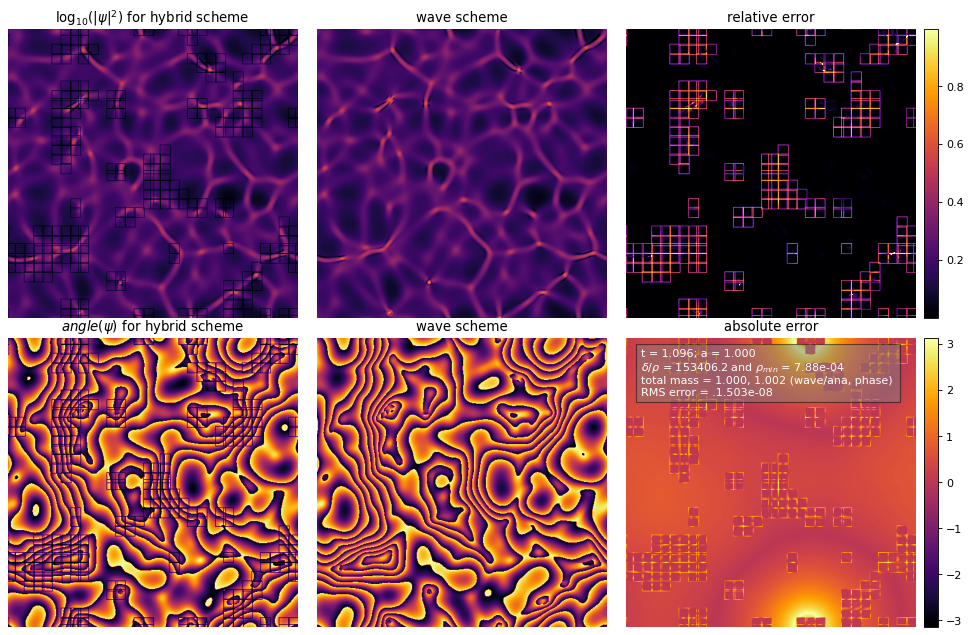

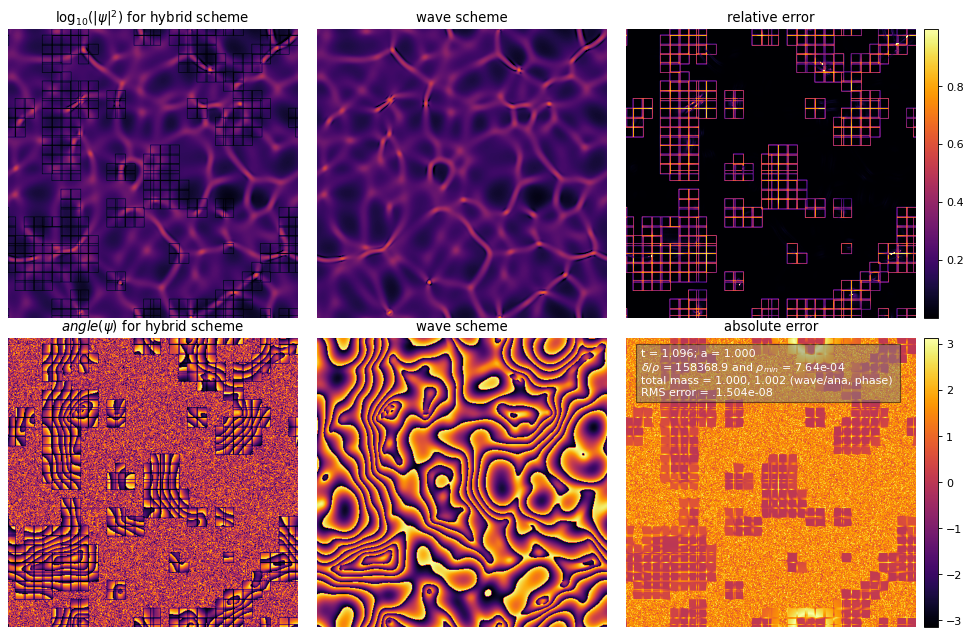

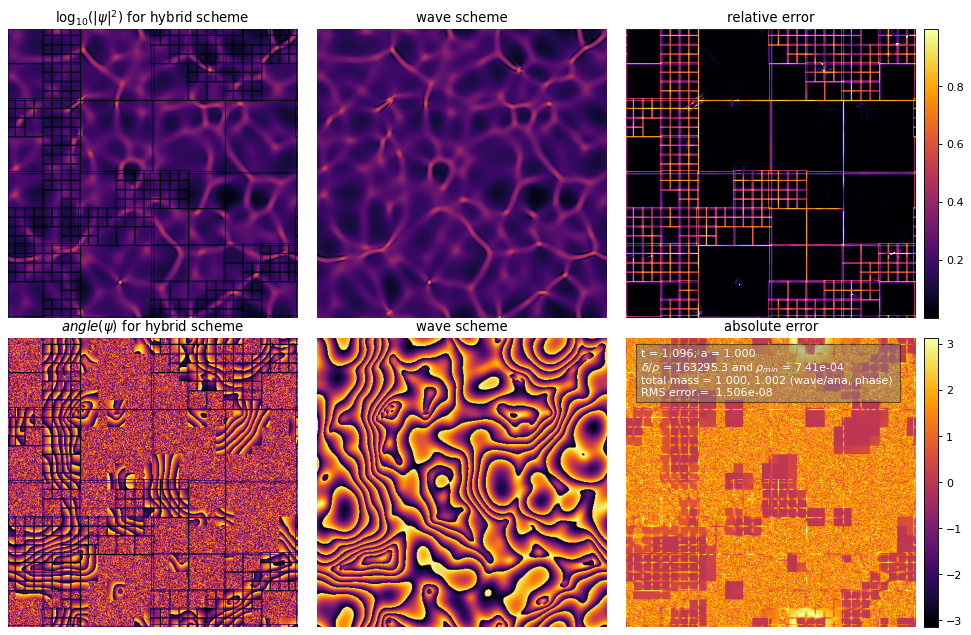

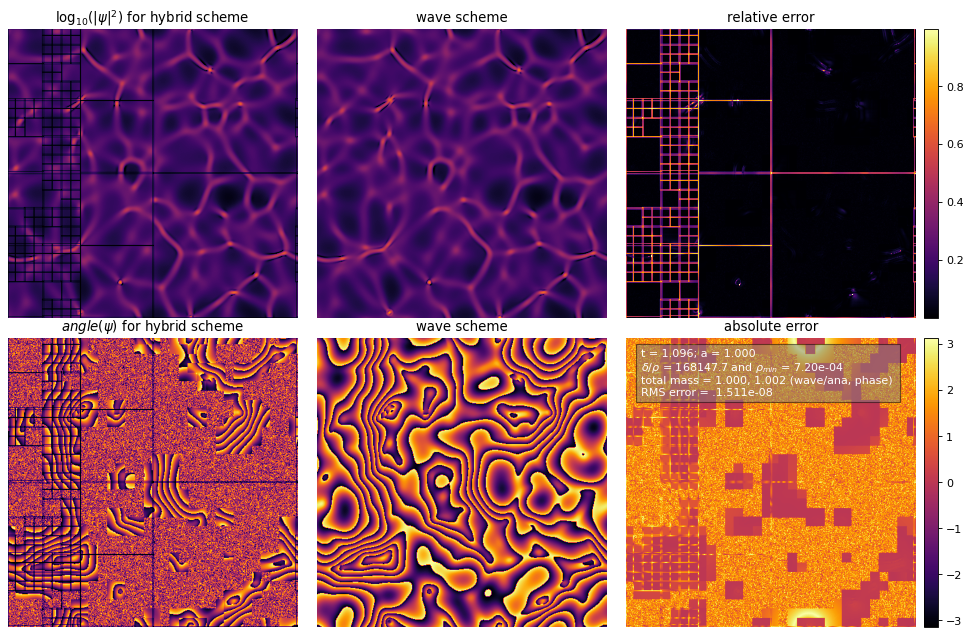

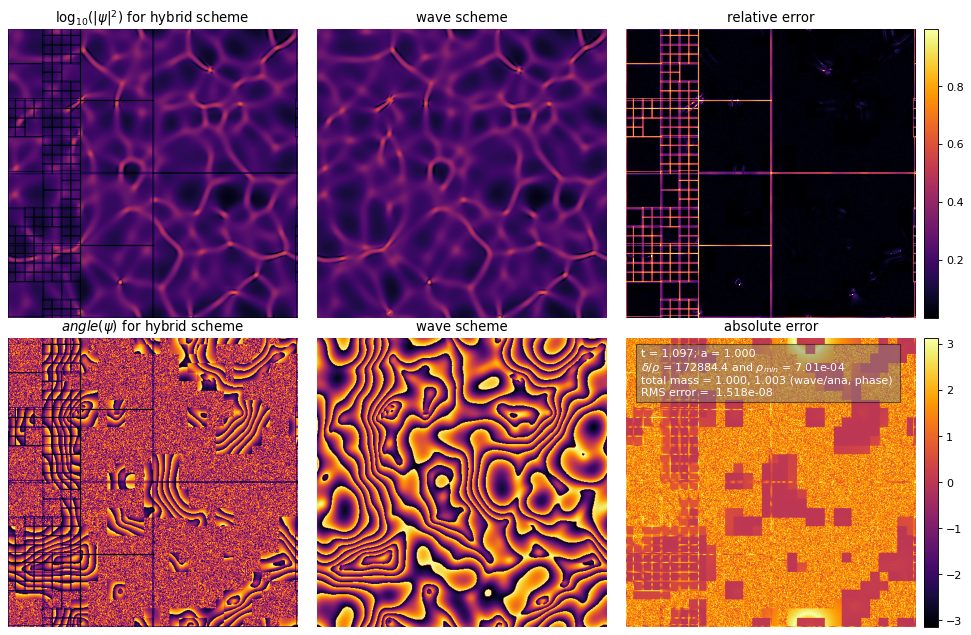

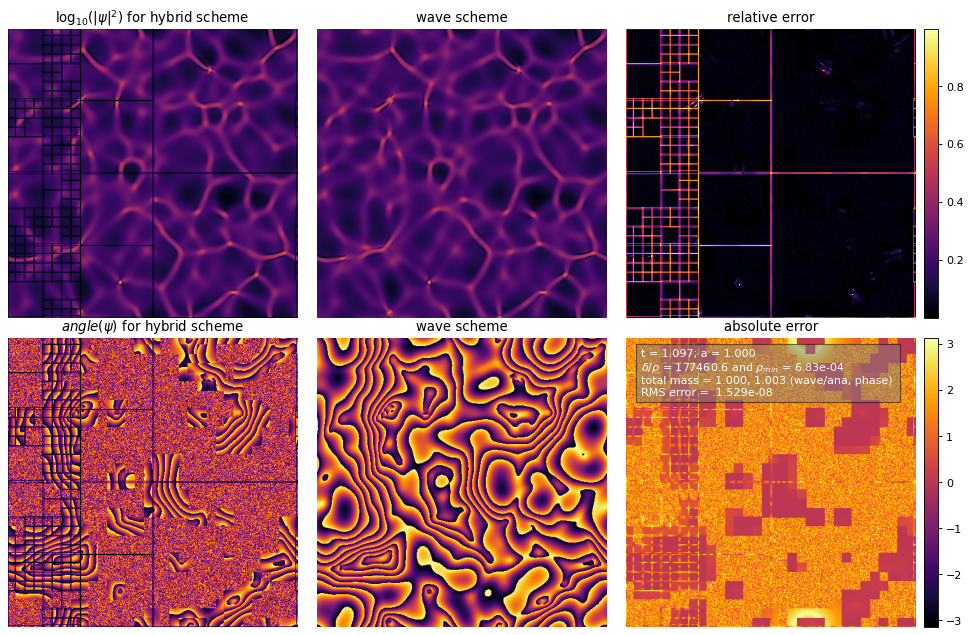

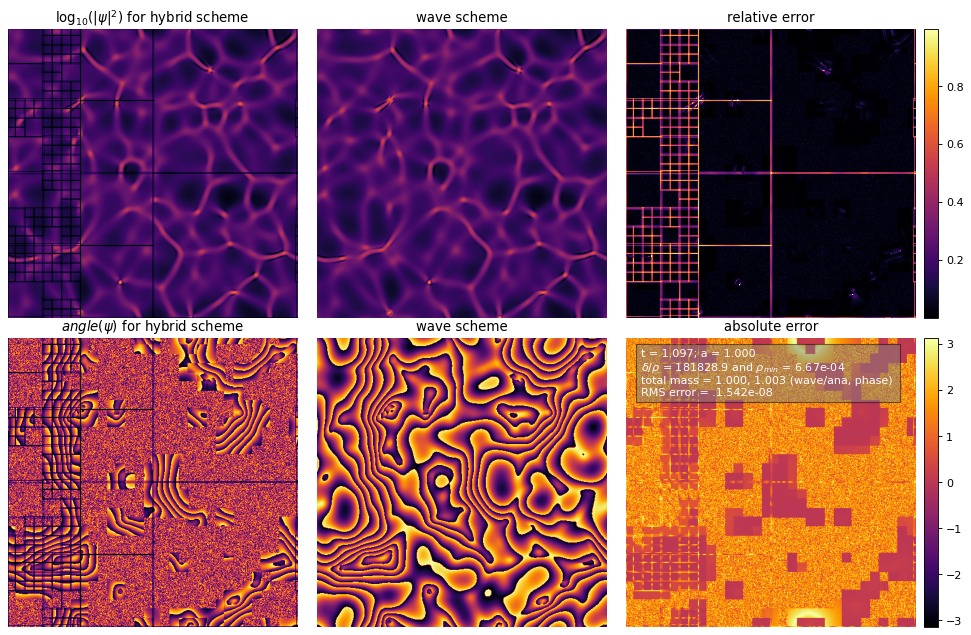

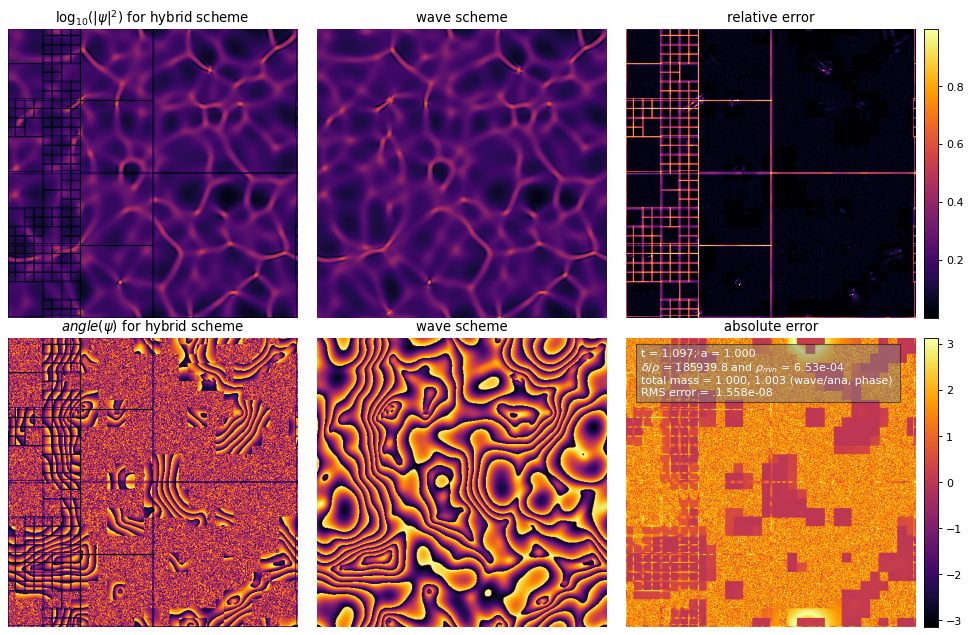

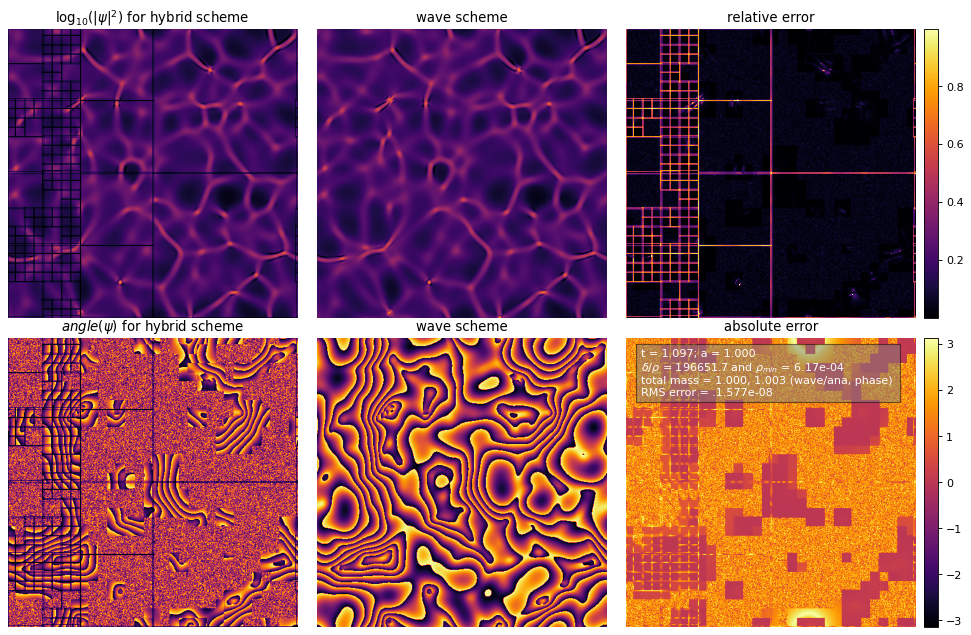

In [5]:
for i in range(10):
    for j in range(20):
        hsolver.step()
        fsolver.step()
        animation.drawFrame(hsolver, "hybrid scheme", config, tests.coefficients_2d, "stub", fsolver)

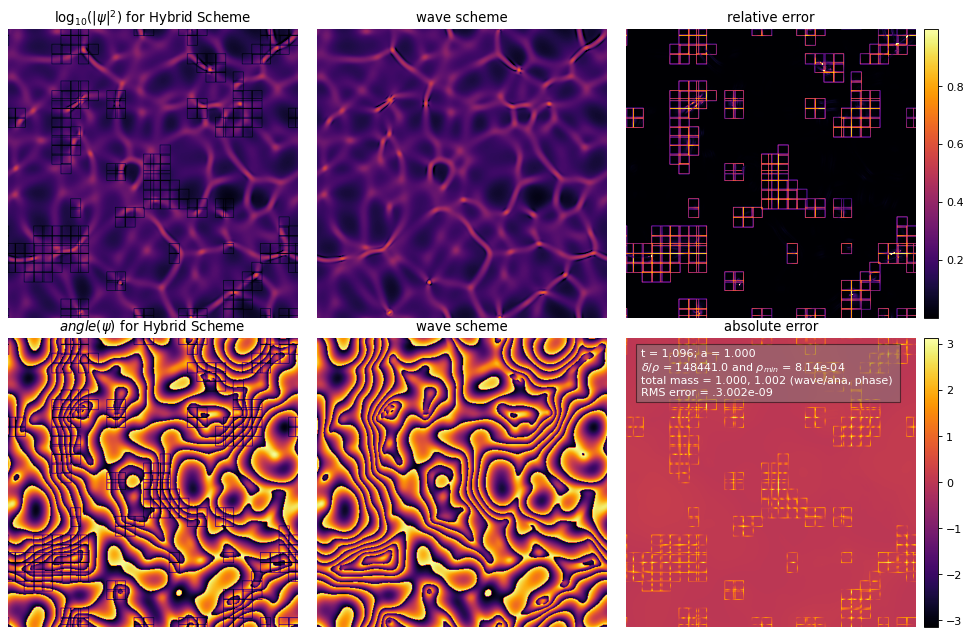

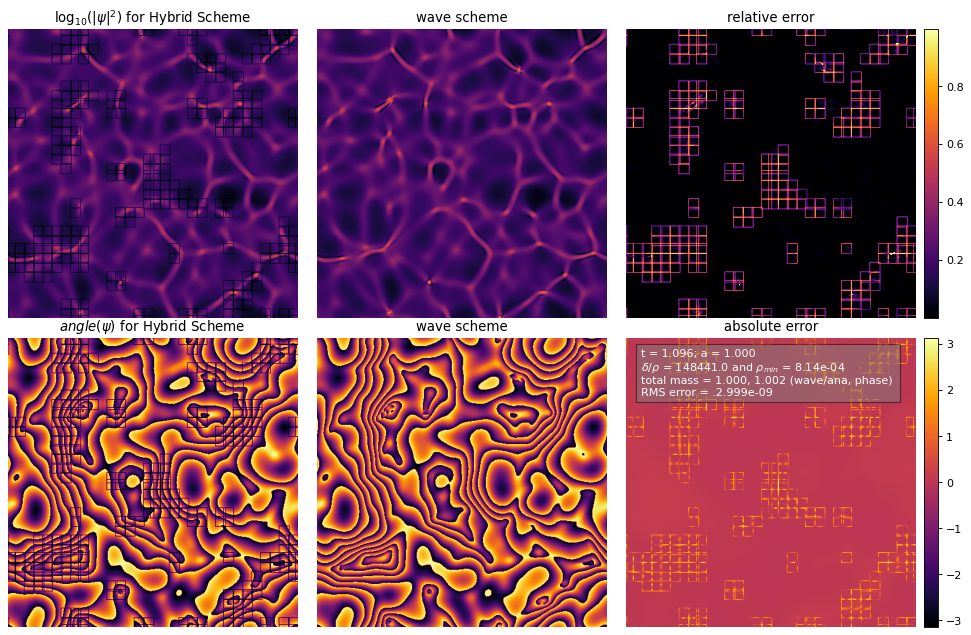

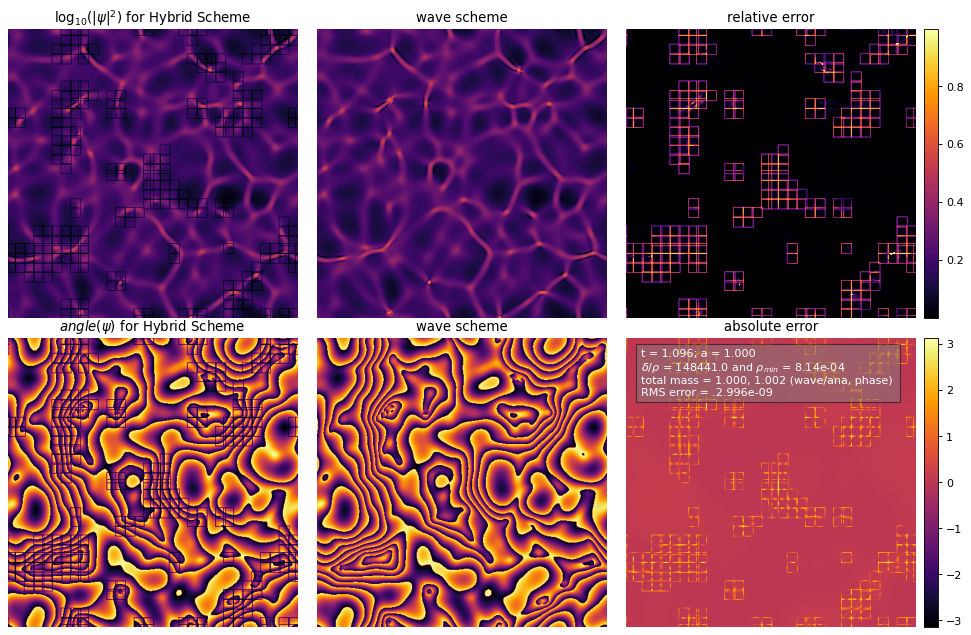

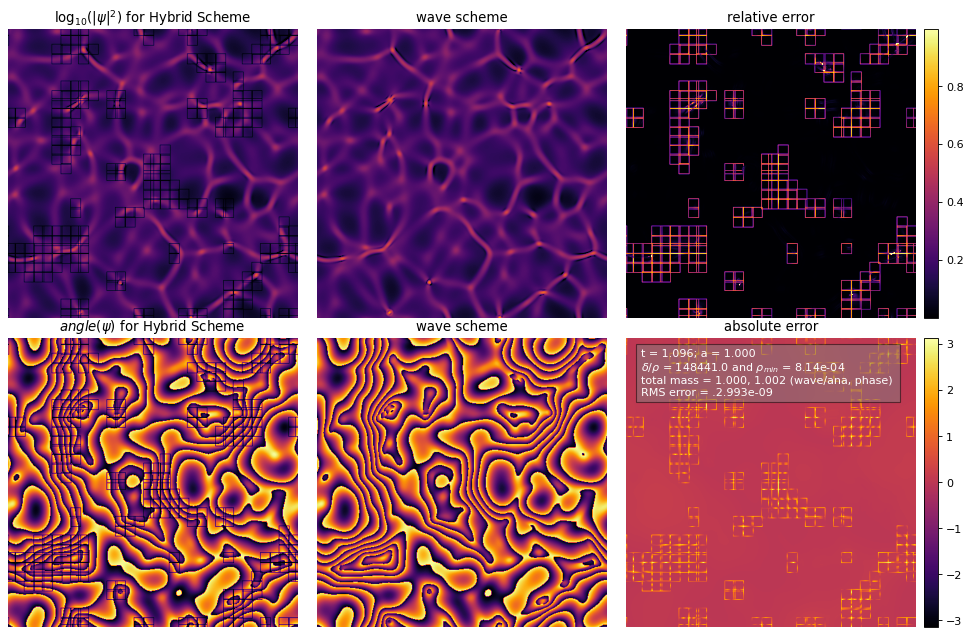

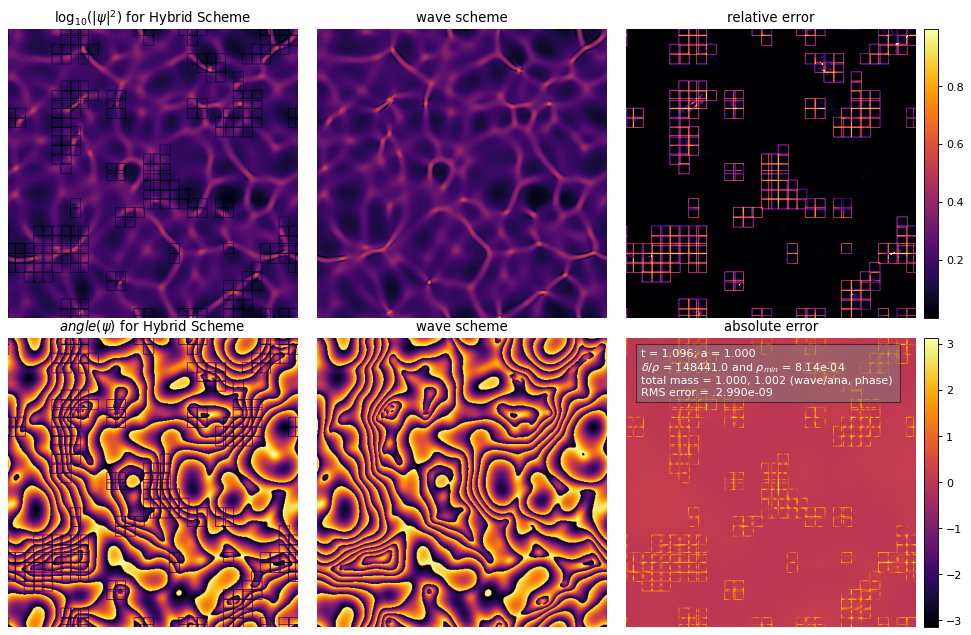

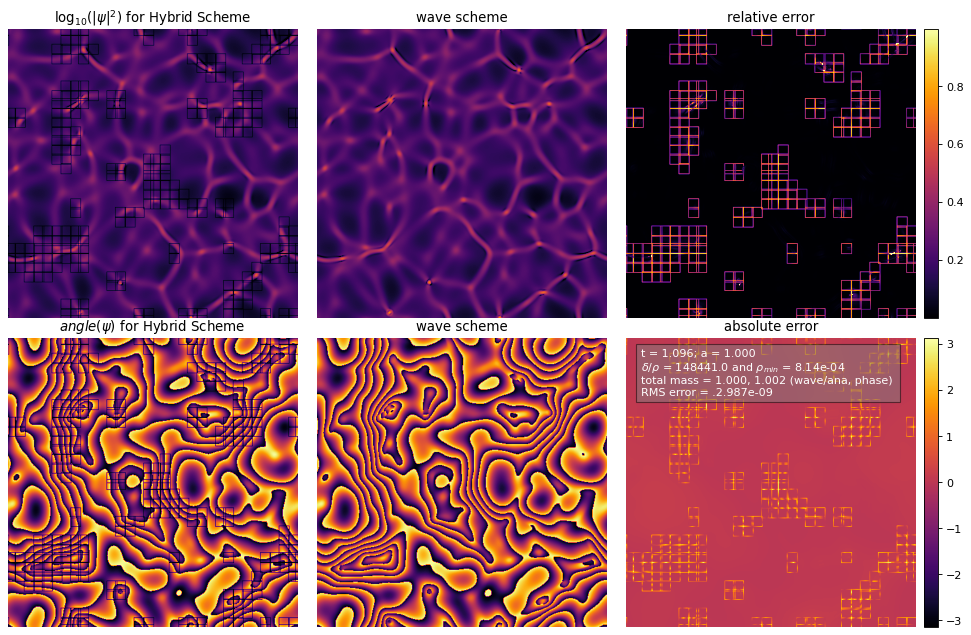

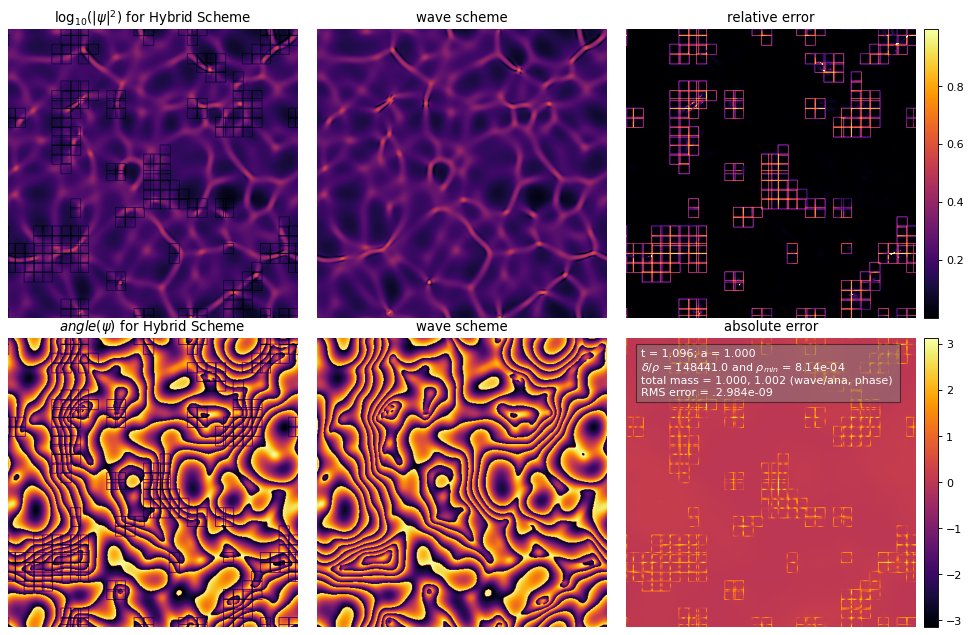

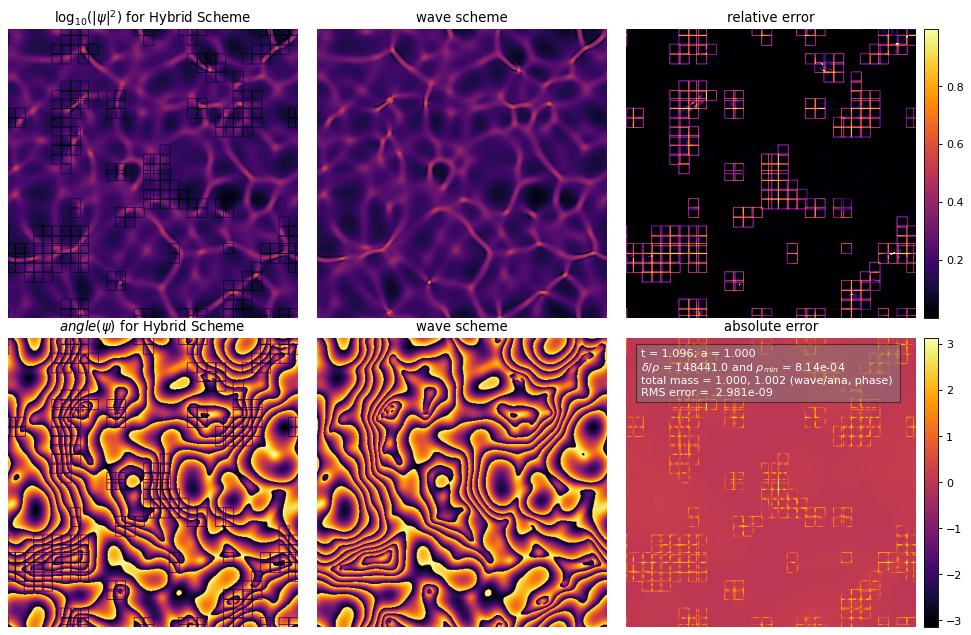

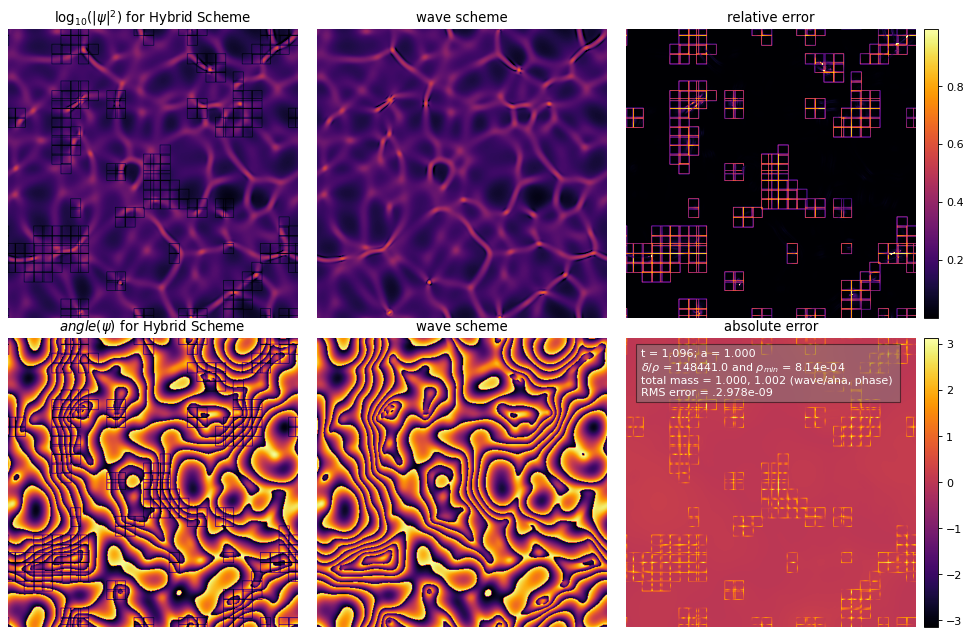

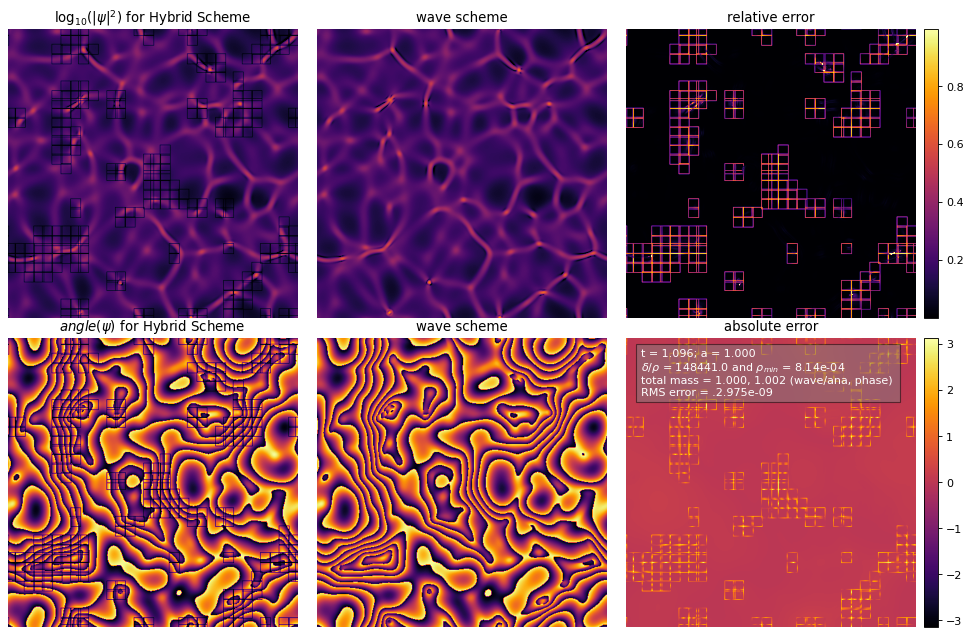

In [50]:
animation.createAnimation()

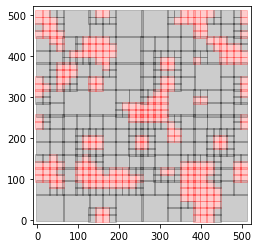

In [46]:
fig, ax = plt.subplots()
ax.set_aspect("equal")
ax.set_ylim([-10, hsolver.N + 10])
ax.set_xlim([-10, hsolver.N + 10])
hsolver.binaryTree.plotTree(ax)

In [ ]:
animation.createAnimation(hsolver, "Hybrid Scheme", config, tests.cosmological2D, "cosmo_hybrid", fsolver)

In [27]:
hsolver.step()

/media/xerox/INTENSO/hybrid_scheme/schemes.py:619: RuntimeWarning: overflow encountered in exp
  * (-sr2r + 16 * srr - 30 * sr + 16 * srl - sr2l)


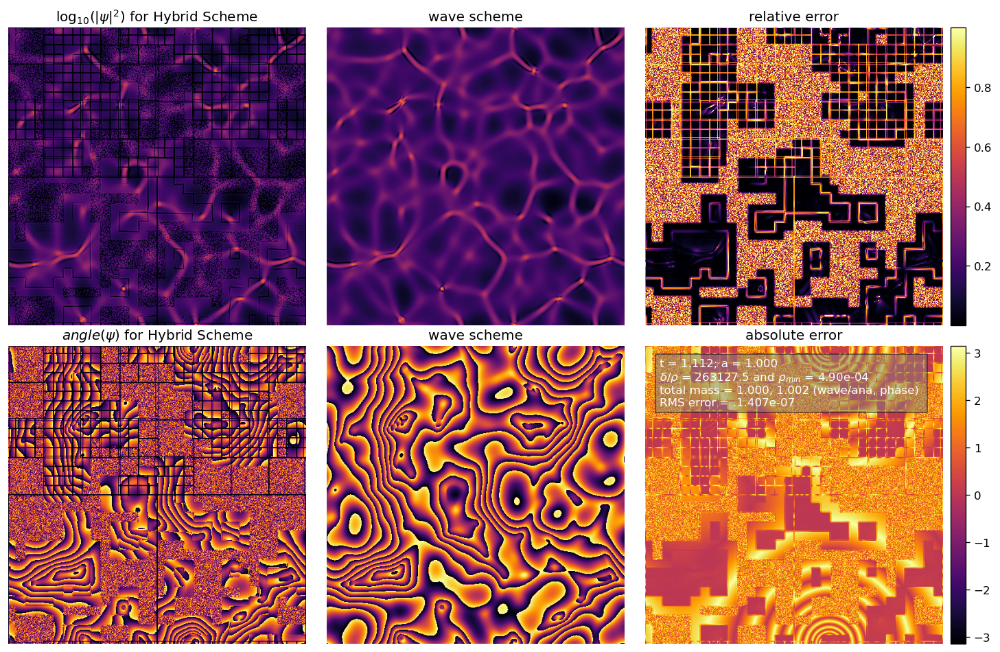

In [28]:
animation.drawFrame(hsolver, "Hybrid Scheme", config, tests.cosmological2D, "stub", fsolver)

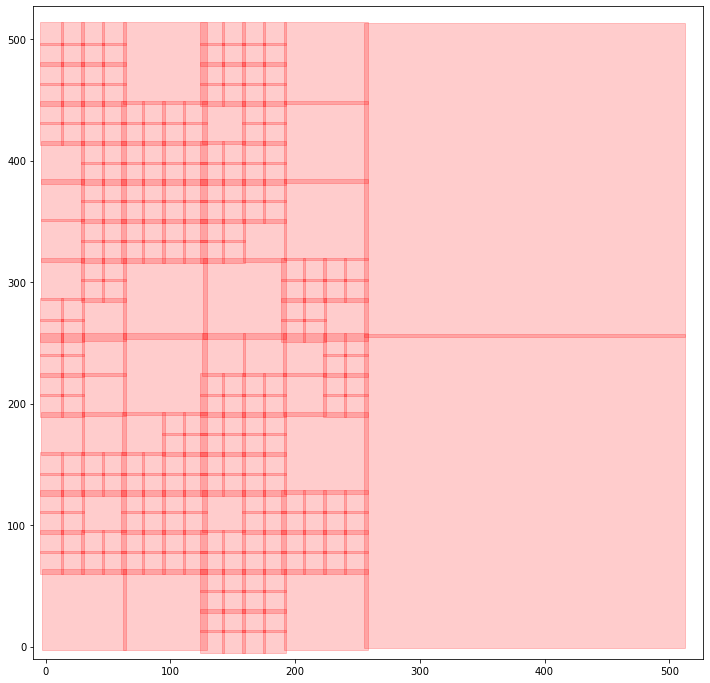

In [29]:
import matplotlib.pyplot as plt 
fig, ax = plt.subplots(figsize=(12, 12))
ax.set_xlim([-10, 527])
ax.set_ylim([-10, 527])
hsolver.binaryTree.plotTree(ax)

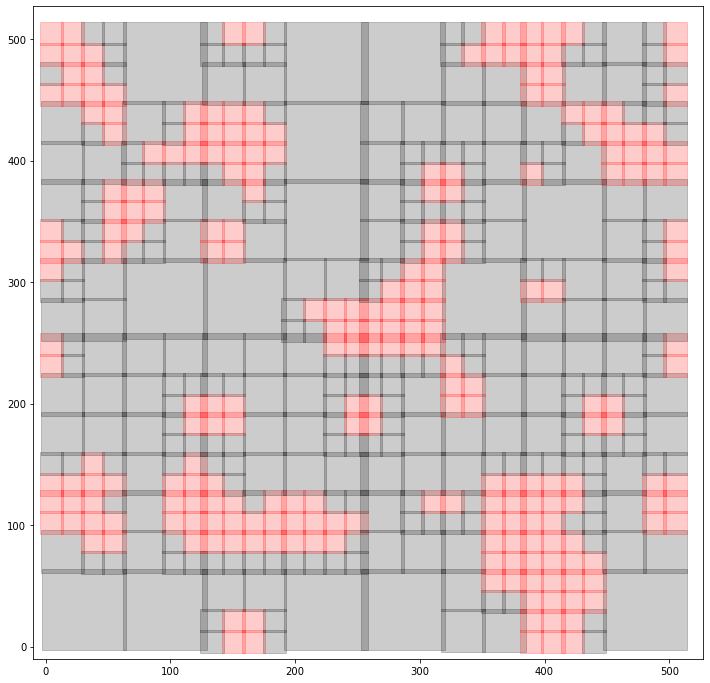

In [24]:
import matplotlib.pyplot as plt 
fig, ax = plt.subplots(figsize=(12, 12))
ax.set_xlim([-10, 527])
ax.set_ylim([-10, 527])
hsolver.binaryTree.plotTree(ax)

Set up nD binary tree with N = 64
Create animation with configuration:  {'dimensions': 1, 'resolution': 64, 'domainSize': 10, 't0': 0, 'tEnd': 2, 'dt': 0.001, 'slowDown': 10, 'interval': 100, 'timeOrder': 2, 'stencilOrder': 4, 'gravity': 1, 'useCosmology': False, 'debug': False, 'useHybrid': False, 'useAdaptiveSubregions': True, 'subregions': [[0.3, 0.3, 0.1, 0.1], [0.3, 0.3, 0.4, 0.4]], 'windowUpdateFrequency': 100, 'WindowSize': 0.5, 'mode': 0, 'enoOrder': 1, 'rhoOrder': 1, 'modifiedPQN': 3, 'xlim': [0, 10], 'densityYlim': [0.0, 1.2], 'phaseYlim': [-3.14, 3.14], 'plotDensityLogarithm': True, 'plotPhaseMod2': True, 'dpi': 80, 'artificialDiffusion': 1, 'fluxMode': 0, 'SPeriodicBoundary': True, 'fluidMode': 0, 'integrationOrigin': [0, 0], 'useSlopeLimiting': False, 'maxSpeedC': 1.0, 'dimension': 2}


/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)
/home/xerox/Documents/Masterarbeit/Jupyter/hybrid_scheme/schemes.py:494: RuntimeWarning: overflow encountered in exp
  return np.exp(2 * self.fields[0])


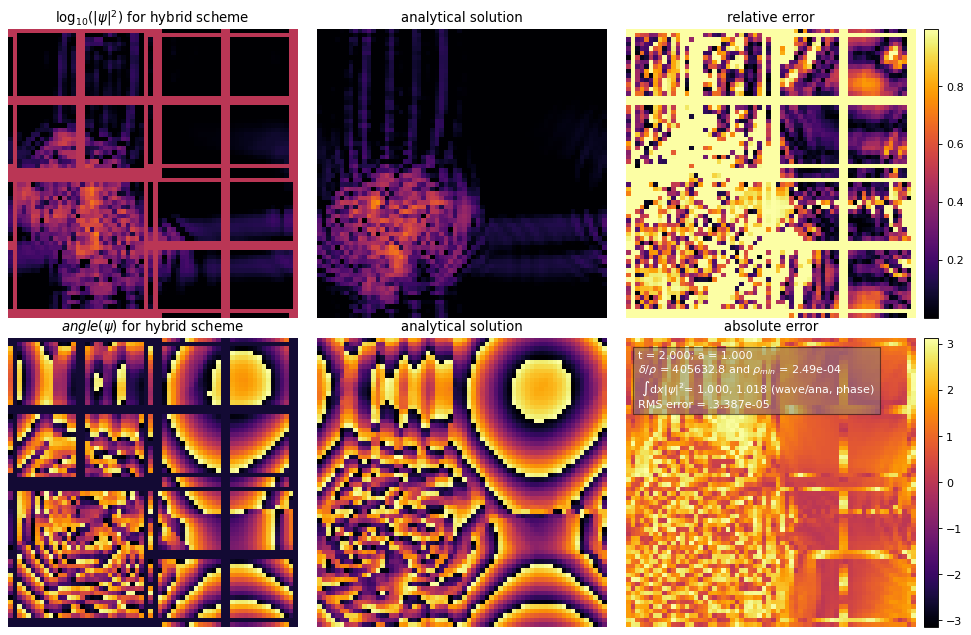

In [1]:
import schemes
import tests
import config
import analysis
import animation

import numpy as np

c = config.generateConfig(dt=1e-4, t0=0)


def resetConfig(c):
    c["dt"] = 1e-4
    c["domainSize"] = 50
    c["resolution"] = 512
    c["timeOrder"] = 2
    c["stencilOrder"] = 4
    c["dimension"] = 2
    c["plotPhaseMod2"] = True
    c["phaseYlim"] = [-3.14, 3.14]
    c["densityYlim"] = [0., 1.2]
    c["subregions"] = [[0.3, 0.3, 0.1, 0.1], [0.3, 0.3, 0.4, 0.4]]
    c["debug"] = False
    c["slowDown"] = 6
    c["tEnd"] = 2
    c["gravity"] = 1
    c["useAdaptiveSubregions"] = True


resetConfig(c)

test = tests.cosmological2D

#UpwindScheme = schemes.ConvectiveScheme(c, test)
fsolver = schemes.SpectralScheme(c, test)
#solver = schemes.ConvectiveScheme(c, test)
solver = schemes.HybridScheme(schemes.ConvectiveScheme, schemes.SubregionScheme, c, test)
#for i in range(1):
#    solver.step()
#animation.drawFrame(solver, "FTCS scheme", c, test, "cosmo")

animation.createAnimation(solver, "Hybrid scheme", c, test, "cosmo_hybrid", fsolver)

Create animation with configuration:  {'dimensions': 1, 'resolution': 128, 'domainSize': 10, 't0': 0, 'tEnd': 0.5, 'dt': 0.0001, 'slowDown': 4, 'interval': 100, 'timeOrder': 2, 'stencilOrder': 4, 'gravity': 0, 'useCosmology': False, 'debug': False, 'useHybrid': False, 'useAdaptiveSubregions': False, 'subregions': [], 'windowUpdateFrequency': 100, 'WindowSize': 0.5, 'mode': 0, 'enoOrder': 1, 'rhoOrder': 1, 'modifiedPQN': 3, 'xlim': [0, 10], 'densityYlim': [0.0, 1.2], 'phaseYlim': [-3.14, 3.14], 'plotDensityLogarithm': True, 'plotPhaseMod2': True, 'dpi': 80, 'artificialDiffusion': 1, 'fluxMode': 0, 'SPeriodicBoundary': True, 'fluidMode': 0, 'integrationOrigin': [0, 0], 'useSlopeLimiting': False, 'maxSpeedC': 1.0, 'dimension': 1}


/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)
/home/xerox/Documents/Masterarbeit/Jupyter/hybrid_scheme/fd.py:154: RuntimeWarning: invalid value encountered in log
  logrho = np.log(rho)


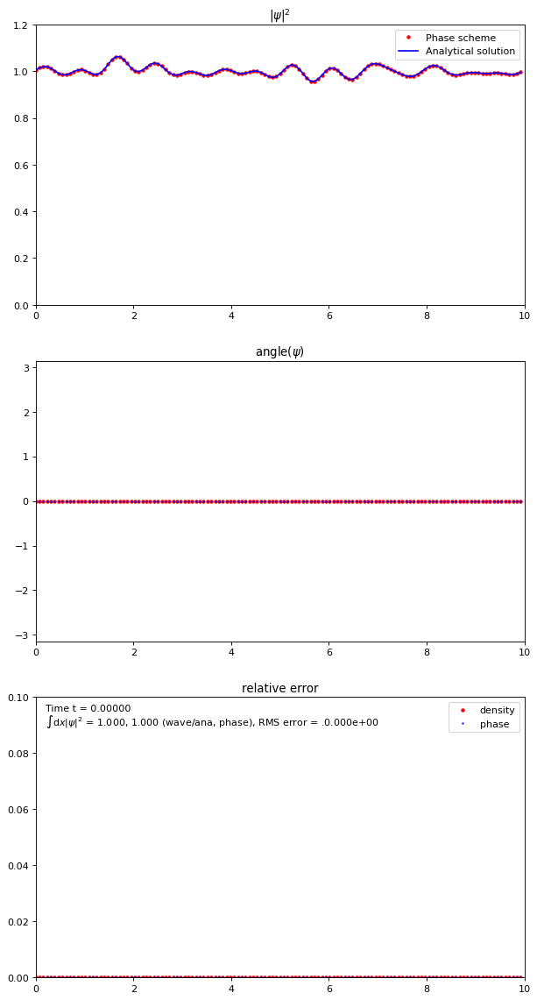

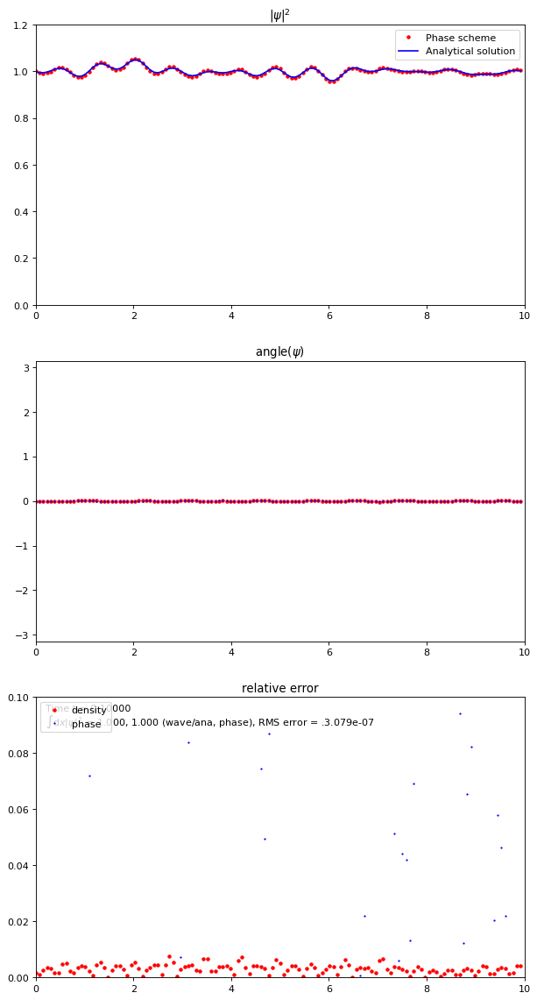

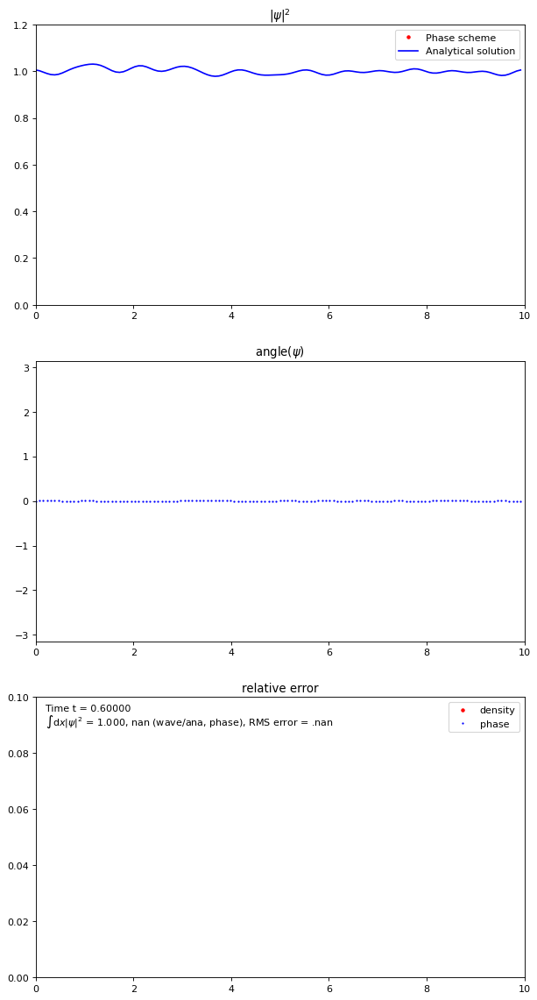

In [2]:
import schemes
import tests
import config
import analysis
import animation

import numpy as np

c = config.generateConfig(dt=1e-4, t0=0)


def resetConfig(c):
    c["dt"] = 1e-4
    c["domainSize"] = 10
    c["resolution"] = 128
    c["timeOrder"] = 2
    c["stencilOrder"] = 4
    c["dimension"] = 1
    c["plotPhaseMod2"] = True
    c["phaseYlim"] = [-3.14, 3.14]
    c["densityYlim"] = [0., 1.2]
    c["subregions"] = []
    c["debug"] = False
    c["slowDown"] = 4
    c["tEnd"] = 0.5
    c["gravity"] = 0
    c["useAdaptiveSubregions"] = False


resetConfig(c)

test = tests.cosmological1D

#UpwindScheme = schemes.ConvectiveScheme(c, test)
solver = schemes.HOUpwindScheme(c, test)
fsolver = schemes.SpectralScheme(c, test)
#solver = schemes.ConvectiveScheme(c, test)
#solver = schemes.HybridScheme(schemes.ConvectiveScheme, schemes.SubregionScheme, c, test)
animation.drawFrame(solver, "Phase scheme", c, test, "cosmo")
for i in range(1000):
    solver.step()
animation.drawFrame(solver, "Phase scheme", c, test, "cosmo")

animation.createAnimation(solver, "Phase scheme", c, test, "phase")

### Li 3


/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)


(<matplotlib.lines.Line2D at 0x7ff6a4646850>,
 Text(0.02, 0.95, 'Time t = 0.00010'),
 Text(0.02, 0.9, '$\\int \\mathrm{d}x|\\psi|^2$ = 1.000, 1.000 (wave/ana, phase), RMS error = .3.517e-07'))

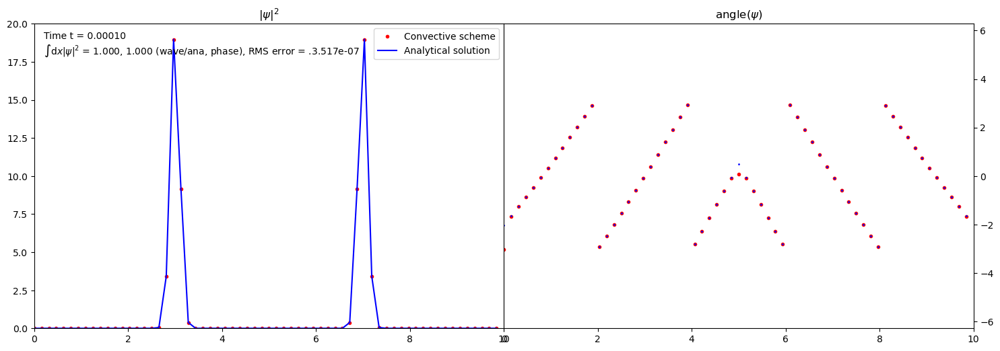

In [2]:
c = config.generateConfig(dt=1e-4, t0=0)


def resetConfig(c):
    c["dt"] = 1e-5
    c["domainSize"] = 10
    c["resolution"] = 64
    c["timeOrder"] = 2
    c["stencilOrder"] = 4
    c["dimension"] = 1
    c["plotPhaseMod2"] = True
    c["densityYlim"] = [0, 20]


resetConfig(c)

solver = schemes.ConvectiveScheme(c, tests.periodicLi3)
for i in range(10):
    solver.step()
animation.drawFrame(solver, "Convective scheme", c, tests.periodicLi3, "li3_order_4_1")


Create animation with configuration:  {'dimensions': 1, 'resolution': 128, 'domainSize': 10, 't0': 0, 'tEnd': 1, 'dt': 0.0001, 'slowDown': 5, 'interval': 100, 'timeOrder': 2, 'stencilOrder': 4, 'gravity': 4000, 'useCosmology': False, 'debug': False, 'useHybrid': False, 'subregions': [], 'windowUpdateFrequency': 100, 'WindowSize': 0.5, 'mode': 0, 'enoOrder': 1, 'rhoOrder': 1, 'modifiedPQN': 3, 'xlim': [0, 10], 'densityYlim': [0, 5], 'phaseYlim': [-6.28, 6.28], 'plotDensityLogarithm': True, 'plotPhaseMod2': True, 'dimension': 1}


/home/xerox/Documents/Masterarbeit/Jupyter/hybrid_scheme/schemes.py:135: RuntimeWarning: overflow encountered in multiply
  ) + (sir - sil) / (2 * dx) * (srr - srl) / (2 * dx)
/home/xerox/Documents/Masterarbeit/Jupyter/hybrid_scheme/schemes.py:141: RuntimeWarning: overflow encountered in square
  + ((sir - sil) / (2 * dx)) ** 2
/home/xerox/Documents/Masterarbeit/Jupyter/hybrid_scheme/schemes.py:142: RuntimeWarning: overflow encountered in square
  - 1 / (8 * dx ** 2) * ((sir - sil) ** 2 + (srr - srl) ** 2)
/home/xerox/Documents/Masterarbeit/Jupyter/hybrid_scheme/schemes.py:137: RuntimeWarning: invalid value encountered in subtract
  -1
/home/xerox/Documents/Masterarbeit/Jupyter/hybrid_scheme/schemes.py:135: RuntimeWarning: invalid value encountered in subtract
  ) + (sir - sil) / (2 * dx) * (srr - srl) / (2 * dx)
/home/xerox/Documents/Masterarbeit/Jupyter/hybrid_scheme/schemes.py:139: RuntimeWarning: invalid value encountered in add
  * (-sr2r + 16 * srr - 30 * sr + 16 * srl - sr2l)
/h

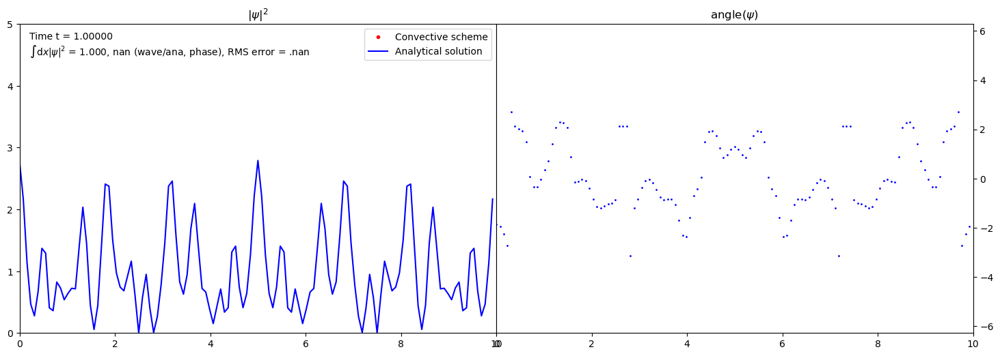

In [3]:
import animation
c = config.generateConfig(dt=1e-4, t0=0)


def resetConfig(c):
    c["dt"] = 1e-4
    c["domainSize"] = 10
    c["resolution"] = 128
    c["timeOrder"] = 2
    c["stencilOrder"] = 4
    c["dimension"] = 1
    c["tEnd"] = 1
    c["slowDown"] = 5
    c["densityYlim"] = [0, 5]


resetConfig(c)
solver = schemes.ConvectiveScheme(c, tests.periodicLi3)
animation.createAnimation(
    solver, "Convective scheme", c, tests.periodicLi3, "li3")


/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)


Create animation with configuration:  {'dimensions': 1, 'resolution': 128, 'domainSize': 10, 't0': 0, 'tEnd': 1, 'dt': 0.0001, 'slowDown': 20, 'interval': 100, 'timeOrder': 0.1, 'stencilOrder': 4, 'gravity': 0, 'useCosmology': False, 'debug': False, 'useHybrid': False, 'subregions': [], 'windowUpdateFrequency': 100, 'WindowSize': 0.5, 'mode': 0, 'enoOrder': 1, 'rhoOrder': 1, 'modifiedPQN': 3, 'xlim': [0, 10], 'densityYlim': [0, 1], 'phaseYlim': [-6.28, 6.28], 'plotDensityLogarithm': True, 'plotPhaseMod2': True, 'dpi': 80, 'dimension': 1}


/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)


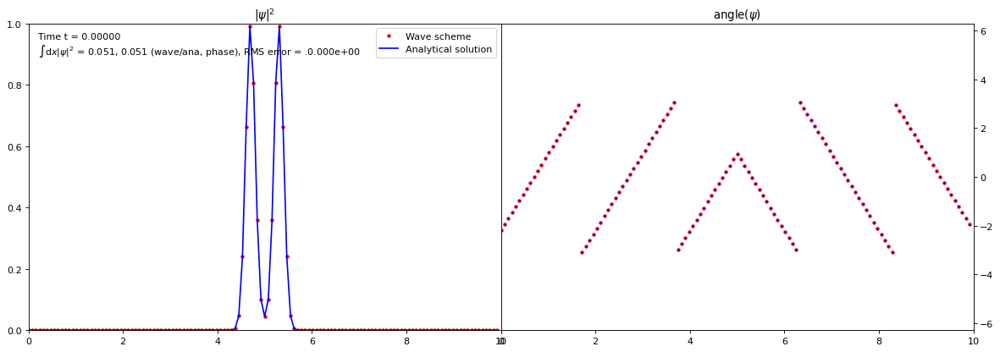

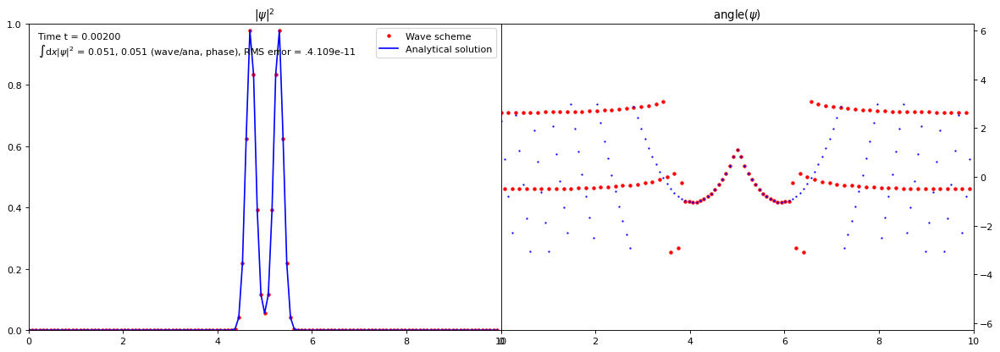

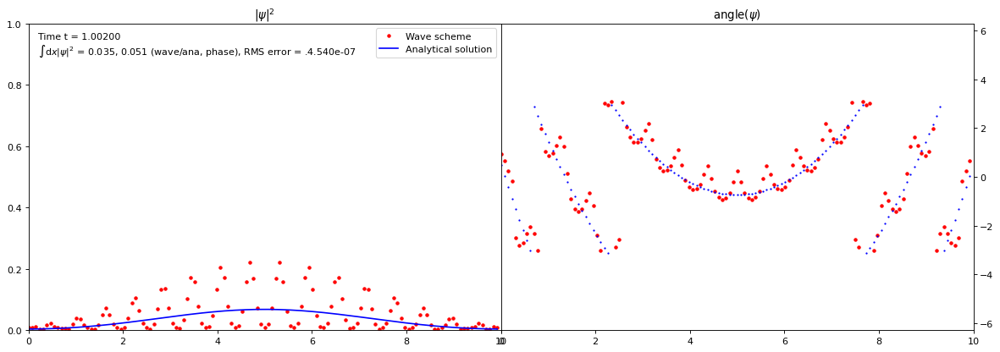

In [4]:
import schemes
import tests
import config
import analysis
import animation

import numpy as np

c = config.generateConfig(dt=1e-4, t0=0)


def resetConfig(c):
    c["dt"] = 1e-4
    c["domainSize"] = 10
    c["resolution"] = 128
    c["timeOrder"] = .1
    c["stencilOrder"] = 4
    c["dimension"] = 1
    c["tEnd"] = 1
    c["slowDown"] = 20
    c["densityYlim"] = [0, 1]
    c["gravity"] = 0


resetConfig(c)
solver = schemes.WaveScheme(c, tests.li3)
animation.drawFrame(solver, "Wave scheme", c, tests.li3, "li3_wave_0")
for i in range(20):
    solver.step()
animation.drawFrame(solver, "Wave scheme", c, tests.li3, "li3_wave_1")
animation.createAnimation(
    solver, "Wave scheme", c, tests.li3, "li3_wave")

# Cosmo 1D


/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)


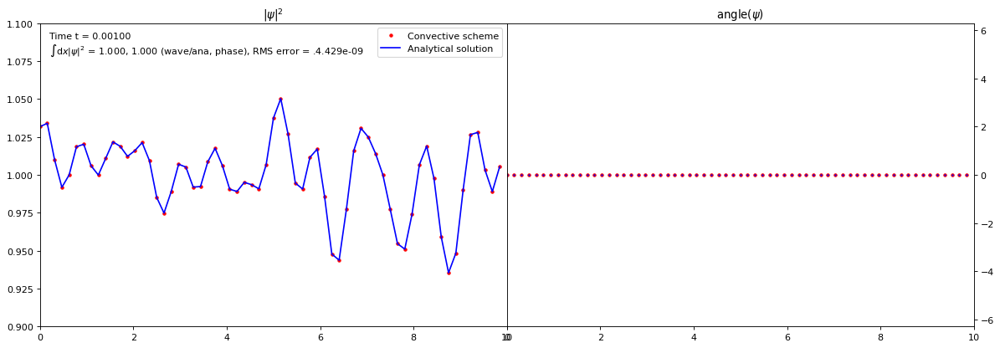

In [2]:
c = config.generateConfig(dt=1e-4, t0=0)


def resetConfig(c):
    c["dt"] = 1e-4
    c["domainSize"] = 10
    c["resolution"] = 64
    c["timeOrder"] = 2
    c["stencilOrder"] = 4
    c["dimension"] = 1
    c["densityYlim"] = [.9, 1.1]


resetConfig(c)

solver = schemes.ConvectiveScheme(c, tests.cosmological1D)
for i in range(10):
    solver.step()
animation.drawFrame(solver, "Convective scheme", c, tests.cosmological1D, "cosmo_nograv_order_4_1")


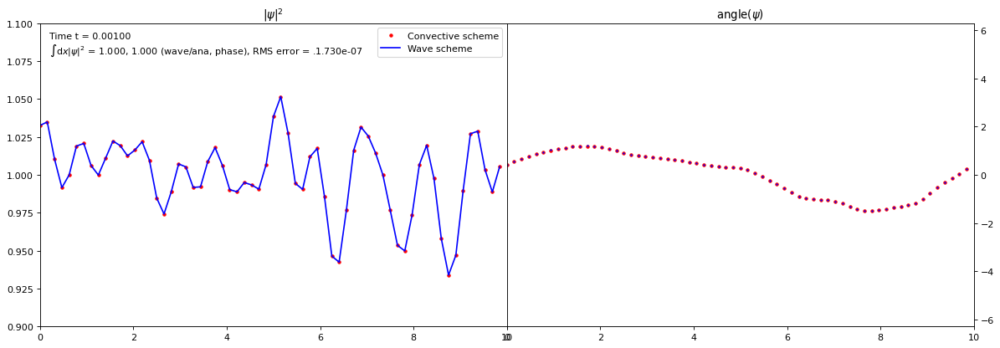

In [5]:
c = config.generateConfig(dt=1e-4, t0=0)


def resetConfig(c):
    c["dt"] = 1e-4
    c["domainSize"] = 10
    c["resolution"] = 64
    c["timeOrder"] = 2
    c["stencilOrder"] = 4
    c["dimension"] = 1
    c["densityYlim"] = [.9, 1.1]
    c["gravity"] = 4000


resetConfig(c)

solver = schemes.ConvectiveScheme(c, tests.cosmological1D)
waveSolver = schemes.WaveScheme(c, tests.cosmological1D)
for i in range(10):
    solver.step()
    waveSolver.step()
animation.drawFrame(solver, "Convective scheme", c, tests.cosmological1D, "cosmo_order_4_1", waveSolver=waveSolver)


Create animation with configuration:  {'dimensions': 1, 'resolution': 128, 'domainSize': 10, 't0': 0, 'tEnd': 2, 'dt': 0.0001, 'slowDown': 5, 'interval': 100, 'timeOrder': 2, 'stencilOrder': 4, 'gravity': 1, 'useCosmology': False, 'debug': False, 'useHybrid': False, 'subregions': [], 'windowUpdateFrequency': 100, 'WindowSize': 0.5, 'mode': 0, 'enoOrder': 1, 'rhoOrder': 1, 'modifiedPQN': 3, 'xlim': [0, 10], 'densityYlim': [0, 10], 'phaseYlim': [-4, 4], 'plotDensityLogarithm': True, 'plotPhaseMod2': True, 'dpi': 80, 'dimension': 1}


/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)
/home/xerox/Documents/Masterarbeit/Jupyter/hybrid_scheme/schemes.py:214: RuntimeWarning: overflow encountered in exp
  return np.exp(2 * self.fields[0])
/home/xerox/Documents/Masterarbeit/Jupyter/hybrid_scheme/fd.py:187: RuntimeWarning: invalid value encountered in true_divide
  V = -np.fft.fft(u) / (kSq + (kSq == 0))


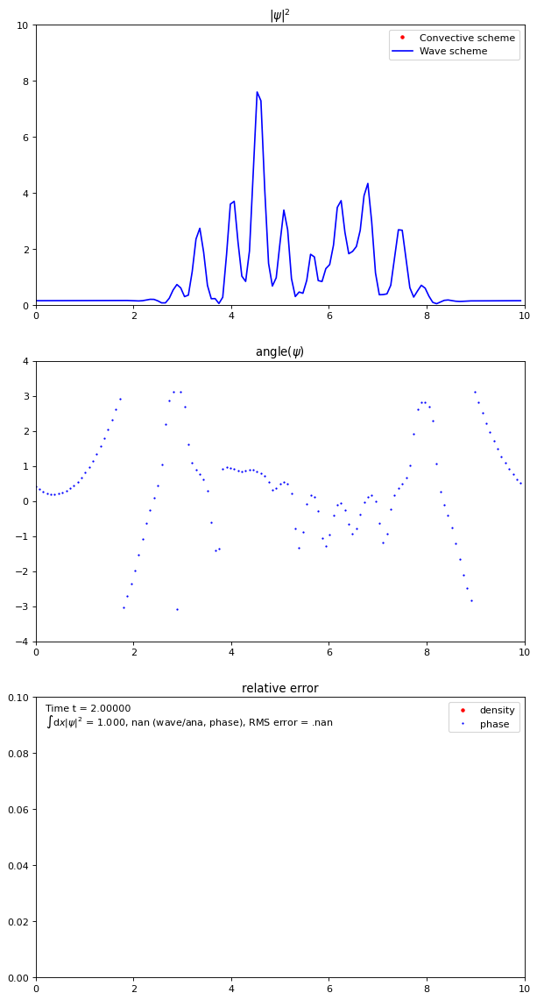

In [6]:
import animation
c = config.generateConfig(dt=1e-4, t0=0)


def resetConfig(c):
    c["dt"] = 1e-4
    c["domainSize"] = 10
    c["resolution"] = 128
    c["timeOrder"] = 2
    c["stencilOrder"] = 4
    c["dimension"] = 1
    c["tEnd"] = 2
    c["slowDown"] = 5
    c["densityYlim"] = [0, 10]
    c["gravity"] = 1
    c["phaseYlim"] = [-4, 4]


resetConfig(c)
solver = schemes.ConvectiveScheme(c, tests.cosmological1D)
waveSolver = schemes.WaveScheme(c, tests.cosmological1D)
animation.createAnimation(
    solver, "Convective scheme", c, tests.cosmological1D, "cosmo", waveSolver=waveSolver)


/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)


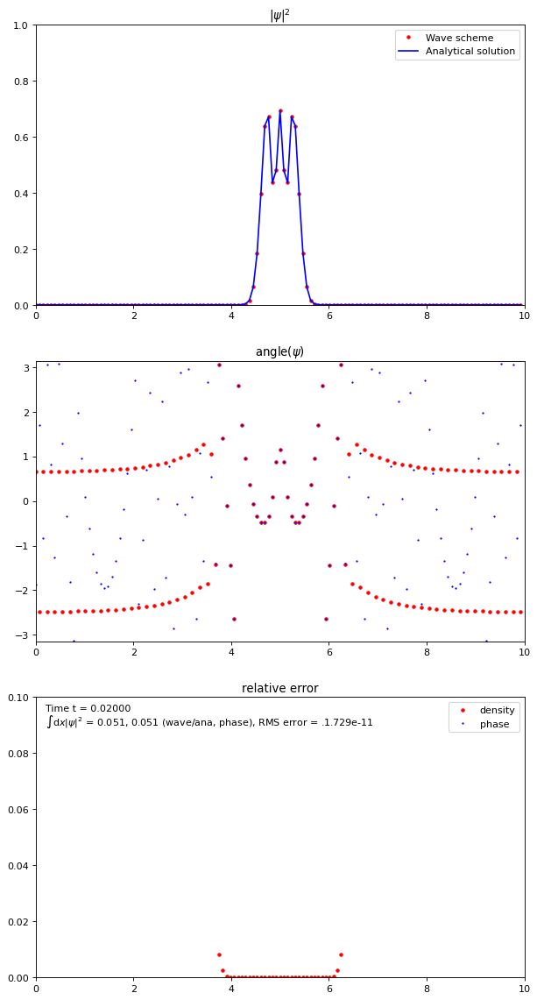

In [1]:
import schemes
import tests
import config
import analysis
import animation

import numpy as np


c = config.generateConfig(dt=1e-4, t0=0)


def resetConfig(c):
    c["dt"] = 1e-4
    c["domainSize"] = 10
    c["resolution"] = 128
    c["timeOrder"] = .1
    c["stencilOrder"] = 4
    c["dimension"] = 1
    c["tEnd"] = 1
    c["slowDown"] = 20
    c["densityYlim"] = [0, 1]
    c["gravity"] = 0

resetConfig(c)

solver = schemes.WaveScheme(c, tests.li3)
for i in range(200):
    solver.step()

animation.drawFrame(solver, "Wave scheme", c, tests.li3, "li3_wave_1")


In [2]:


import fd_1d as fd 

rho = solver.getDensity()
phase = solver.getPhase()
dx = solver.dx 
xx = solver.getGrid()[0]

def getCurvature(f, dx):
    lap_f = fd.getC2Laplacian(f, dx)
    res   = lap_f / (f + (f==0))
    return res 

vx          = fd.getC2Gradient(phase, dx)
v2          = vx**2 
rho_kappa   = getCurvature(rho, dx)
phase_kappa = getCurvature(phase, dx)
y           = v2 + rho_kappa
y[y<0.5] = 0
y2 = fd.deltaSi(rho, phase, dx)

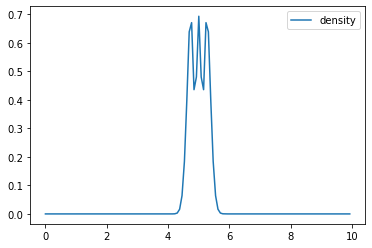

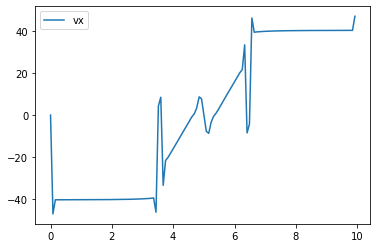

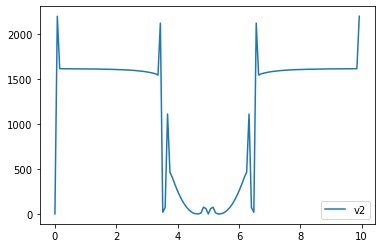

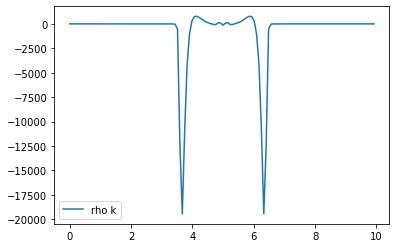

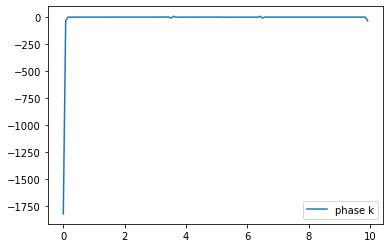

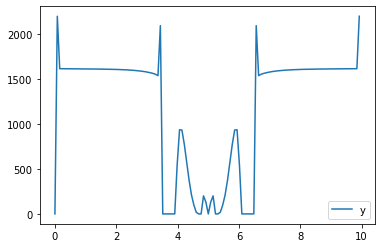

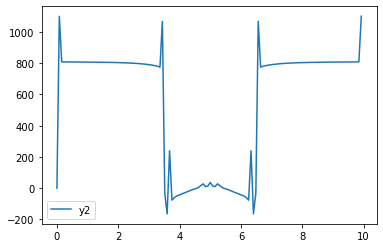

In [3]:
import matplotlib.pyplot as plt 

plt.plot(xx, rho, label="density")
plt.legend()
plt.show()
plt.plot(xx, vx, label="vx")
plt.legend()
plt.show()
plt.plot(xx, v2, label="v2")
plt.legend()
plt.show()
plt.plot(xx, rho_kappa, label="rho k")
plt.legend()
plt.show()
plt.plot(xx, phase_kappa, label="phase k")
plt.legend()
plt.show()
plt.plot(xx, y, label="y")
plt.legend()
plt.show()

plt.plot(xx, y2, label="y2")
plt.legend()
plt.show()

/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)


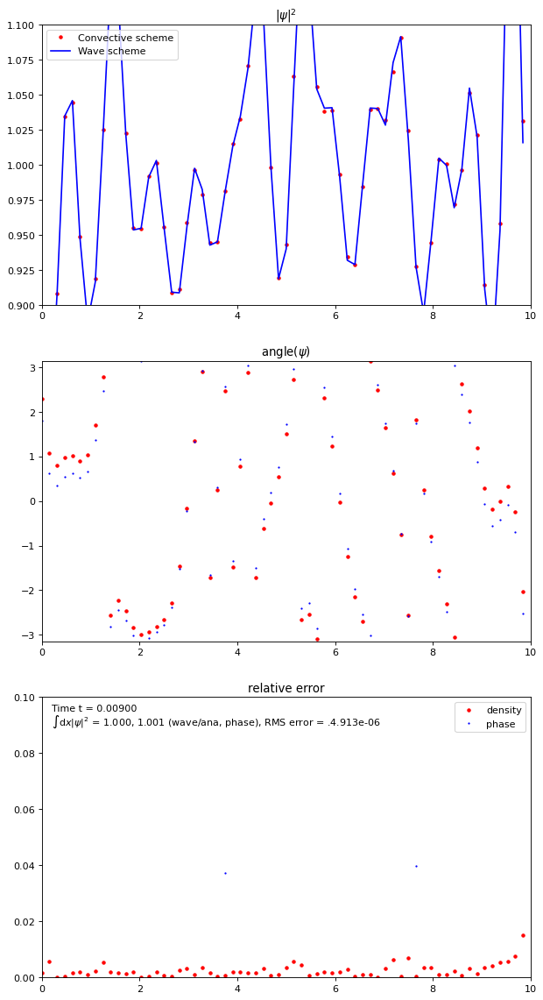

In [2]:
import schemes
import tests
import config
import analysis
import animation

import numpy as np

c = config.generateConfig(dt=1e-4, t0=0)


def resetConfig(c):
    c["dt"] = 1e-4
    c["domainSize"] = 10
    c["resolution"] = 64
    c["timeOrder"] = 2
    c["stencilOrder"] = 4
    c["dimension"] = 1
    c["densityYlim"] = [.9, 1.1]
    c["gravity"] = 4000


resetConfig(c)

solver = schemes.ConvectiveScheme(c, tests.cosmological1D)
waveSolver = schemes.WaveScheme(c, tests.cosmological1D)
for i in range(90):
    solver.step()
    waveSolver.step()
animation.drawFrame(solver, "Convective scheme", c, tests.cosmological1D, "cosmo_order_4_1", waveSolver=waveSolver)


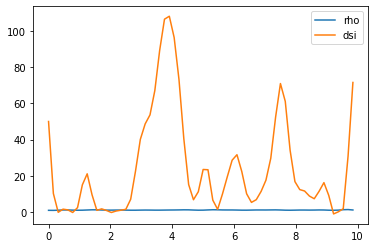

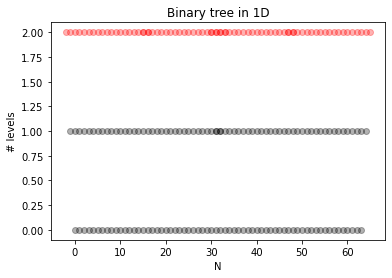

In [3]:
import tests 
import numpy as np 
import matplotlib.pyplot as plt 
import fd
import tree
N = solver.N
L = solver.L
dx = solver.dx
xx = solver.grid[0]
rho = solver.getDensity()
phase = solver.getPhase()
plt.plot(xx, rho, label="rho")

dsi = fd.deltaSi(rho, phase, dx)
plt.plot(xx, dsi, label="dsi")
plt.legend()
plt.show()


t = tree.Node(0, N, 0, N, 1)
t.update([rho, np.abs(dsi)])
fig, ax = plt.subplots()
t.plotTree(ax, root=True)


AttributeError: 'Node' object has no attribute 'needsWave'

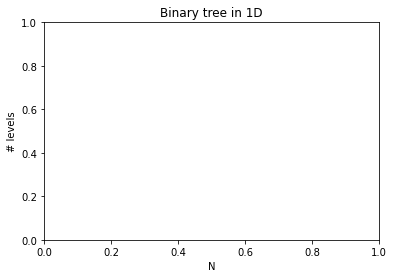

In [5]:
import tree
xx = np.linspace(0, 1, 64)
density = (xx > 0.45)*1

t = tree.Node(0, 64, 0, 64, 1)
t.update([density, phase])
fig, ax = plt.subplots()
t.plotTree(ax, root=True)

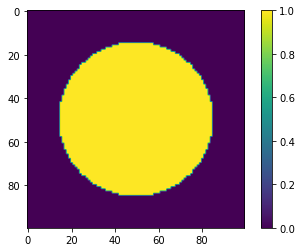

In [1]:
import matplotlib.pyplot as plt 
import tree
import numpy as np 
xx = np.linspace(-1, 1, 100)
xx, yy = np.meshgrid(xx, xx)
density = (np.exp(-xx**2 - yy**2) > 0.6)*1
plt.imshow(density > 0.6)
plt.colorbar()

0.6076
0.6109467455621301
0.9961734693877551
0.7117346938775511
1.0
1.0
0.60546875
0.27734375
0.7117346938775511
1.0
0.60546875
1.0
0.27734375
0.0012755102040816326
0.03125
0.0
0.0
0.0
0.6109467455621301
0.7117346938775511
1.0
1.0
0.27734375
0.60546875
0.9961734693877551
0.0012755102040816326
0.0
0.03125
0.0
0.0
0.7117346938775511
0.60546875
1.0
0.27734375
1.0
0.6109467455621301
0.7117346938775511
1.0
0.27734375
1.0
0.60546875
0.0012755102040816326
0.0
0.0
0.03125
0.0
0.9961734693877551
0.7117346938775511
0.60546875
0.27734375
1.0
1.0
0.6109467455621301
0.0012755102040816326
0.0
0.0
0.0
0.03125
0.7117346938775511
0.27734375
1.0
0.60546875
1.0
0.7117346938775511
0.27734375
0.60546875
1.0
1.0
0.9961734693877551


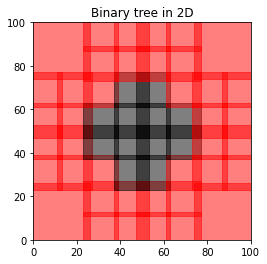

In [2]:
t = tree.Node(0, 100,  [0, 0], 100, 2)
t.update([density])
fig, ax = plt.subplots()
ax.set_xlim([0,100])
ax.set_ylim([0,100])
ax.set_aspect('equal', 'box')
t.plotTree(ax, root=True)

/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)


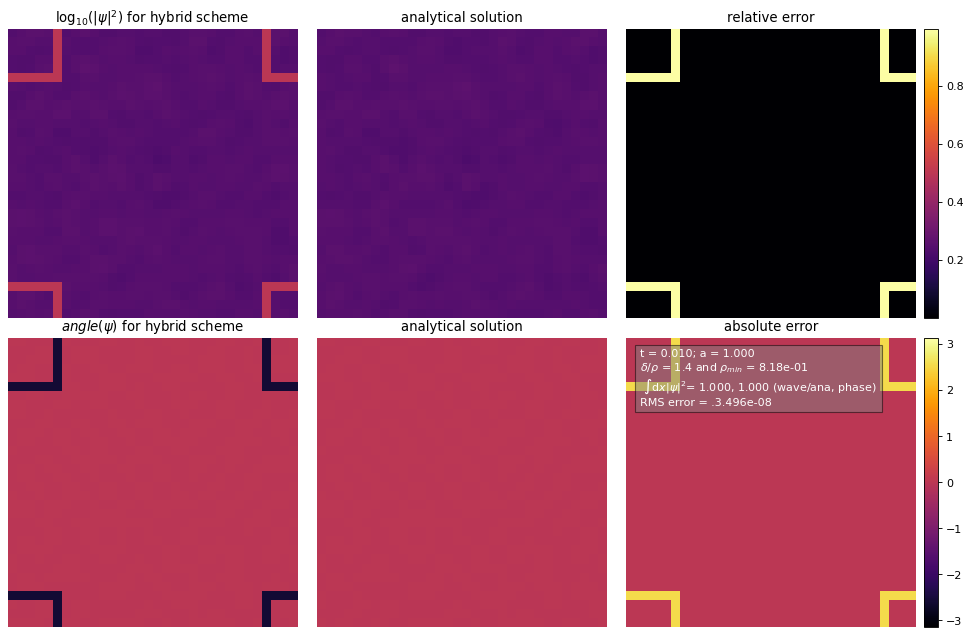

In [5]:
import schemes
import tests
import config
import analysis
import animation

import numpy as np

c = config.generateConfig(dt=1e-4, t0=0)


def resetConfig(c):
    c["dt"] = 1e-4
    c["domainSize"] = 10
    c["resolution"] = 32
    c["timeOrder"] = 2
    c["stencilOrder"] = 4
    c["dimension"] = 2
    c["useHybrid"] = True 
    c["slowDown"] = 5
    c["subregions"] = [[0.3, 0.3, 0.9, 0.9]]


resetConfig(c)
test = tests.cosmological2D
solver = schemes.HybridScheme(schemes.ConvectiveScheme, schemes.SubregionScheme, c, test)
for i in range(100):
    solver.step()
animation.drawFrame(solver, "Hybrid scheme", c, test, "cosmo_hybrid_1")


Create animation with configuration:  {'dimensions': 1, 'resolution': 32, 'domainSize': 10, 't0': 0, 'tEnd': 1.0, 'dt': 0.0001, 'slowDown': 5, 'interval': 100, 'timeOrder': 2, 'stencilOrder': 4, 'gravity': 0, 'useCosmology': False, 'debug': False, 'useHybrid': True, 'subregions': [[0.3, 0.3, 0.9, 0.9]], 'windowUpdateFrequency': 100, 'WindowSize': 0.5, 'mode': 0, 'enoOrder': 1, 'rhoOrder': 1, 'modifiedPQN': 3, 'xlim': [0, 10], 'densityYlim': [0, 10], 'phaseYlim': [-3.14, 3.14], 'plotDensityLogarithm': True, 'plotPhaseMod2': True, 'dpi': 80, 'dimension': 2}


/home/xerox/anaconda3/lib/python3.8/site-packages/numpy/lib/npyio.py:713: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  val = np.asanyarray(val)


FileNotFoundError: [Errno 2] No such file or directory: '2d_plots/gifs/cosmo.gif'

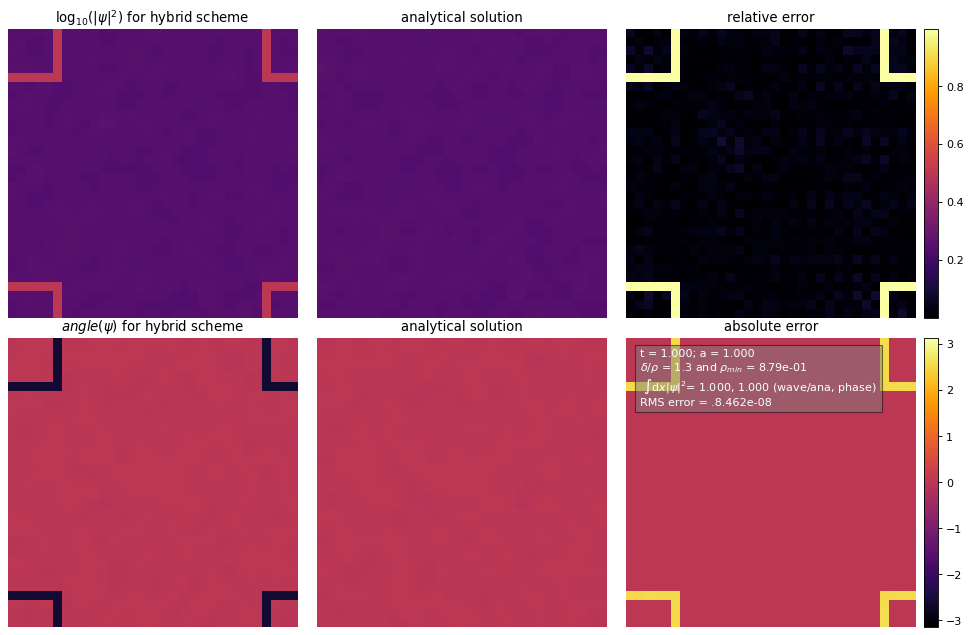

In [7]:
resetConfig(c)
solver = schemes.HybridScheme(schemes.ConvectiveScheme, schemes.SubregionScheme, c, test)
animation.createAnimation(
    solver, "Hybrid scheme", c, test, "cosmo")